# Predicting Status of Water Pumps in Tanzania

##### Importing the Libraries

In [144]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
#To ignore the warnings
import warnings
warnings.filterwarnings("ignore")

##### Reading the files and storing them in dataframe

In [3]:
twp = pd.read_csv("Training_Set.csv")
twp2 = pd.read_csv("Training_Lables.csv")
twp3=pd.read_csv('Test_Set.csv')

##### Combining the target feature to the main data frame

In [4]:
twp['status_group']=twp2['status_group']

##### Understanding the Data

Printing the top 5 entries of the data 

In [5]:
#This work was done by A1
twp.head().T

,0,1,2,3,4
id,69572,8776,34310,67743,19728
amount_tsh,6000.0,0.0,25.0,0.0,0.0
date_recorded,2011-03-14,2013-03-06,2013-02-25,2013-01-28,2011-07-13
funder,Roman,Grumeti,Lottery Club,Unicef,Action In A
gps_height,1390,1399,686,263,0
installer,Roman,GRUMETI,World vision,UNICEF,Artisan
longitude,34.938093,34.698766,37.460664,38.486161,31.130847
latitude,-9.856322,-2.147466,-3.821329,-11.155298,-1.825359
wpt_name,none,Zahanati,Kwa Mahundi,Zahanati Ya Nanyumbu,Shuleni
num_private,0,0,0,0,0


In [6]:
twp3.head().T

,0,1,2,3,4
id,50785,51630,17168,45559,49871
amount_tsh,0.0,0.0,0.0,0.0,500.0
date_recorded,2013-02-04,2013-02-04,2013-02-01,2013-01-22,2013-03-27
funder,Dmdd,Government Of Tanzania,NaN,Finn Water,Bruder
gps_height,1996,1569,1567,267,1260
installer,DMDD,DWE,NaN,FINN WATER,BRUDER
longitude,35.290799,36.656709,34.767863,38.058046,35.006123
latitude,-4.059696,-3.309214,-5.004344,-9.418672,-10.950412
wpt_name,Dinamu Secondary School,Kimnyak,Puma Secondary,Kwa Mzee Pange,Kwa Mzee Turuka
num_private,0,0,0,0,0


Getting a short summary using .info()

In [7]:
twp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 59400 entries, 0 to 59399
Data columns (total 41 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     59400 non-null  int64  
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 55765 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              55745 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59029 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

Finding the number of unique records in each column using .unique()

In [8]:
twp.nunique()

id                       59400
amount_tsh                  98
date_recorded              356
funder                    1897
gps_height                2428
installer                 2145
longitude                57516
latitude                 57517
wpt_name                 37400
num_private                 65
basin                        9
subvillage               19287
region                      21
region_code                 27
district_code               20
lga                        125
ward                      2092
population                1049
public_meeting               2
recorded_by                  1
scheme_management           12
scheme_name               2696
permit                       2
construction_year           55
extraction_type             18
extraction_type_group       13
extraction_type_class        7
management                  12
management_group             5
payment                      7
payment_type                 7
water_quality                8
quality_

Getting the count of null values in the data set using .isnull()

In [9]:
#This work was done by A2
twp.isnull().sum()

id                           0
amount_tsh                   0
date_recorded                0
funder                    3635
gps_height                   0
installer                 3655
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 371
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_

# Data Visualization EDA

Finding the percentage for status of the water pumps

In [10]:
#This work was done by A2
twp['status_group'].value_counts(normalize=True)

functional                 0.543081
non functional             0.384242
functional needs repair    0.072677
Name: status_group, dtype: float64

<Axes: xlabel='status_group', ylabel='count'>

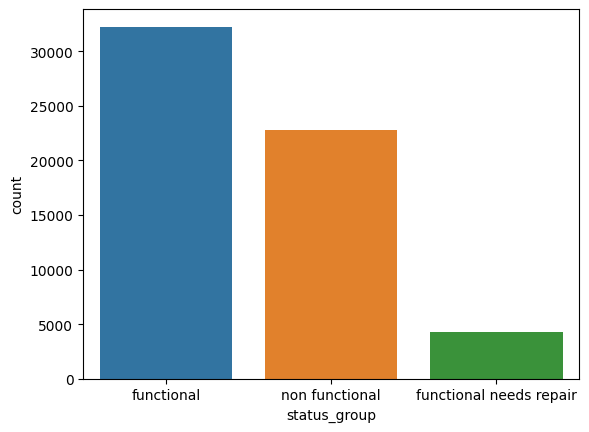

In [11]:
sns.countplot(x="status_group", data=twp)

In [171]:
#This work was done by A1
import folium

d=twp
# Create a map centered on Tanzania
map = folium.Map(location=[-6.3690, 34.8888], zoom_start=6)

#Adding markers to the map 
for index, row in d.iterrows():
    lat = row['latitude']
    lon = row['longitude']
    pump_status = row['status_group']
    
    #To Determine the marker color based on the pump status
    if pump_status == 'functional':
        color = 'green'
    elif pump_status == 'functional needs repair':
        color = 'yellow'
    else:
        color = 'red'
    
    # Adding a marker to the map with the pump location
    folium.CircleMarker(location=[lat, lon], color=color, fill=True, fill_color=color, radius=1).add_to(map)
    
legend_html = '''
    <div style="position: fixed; 
                bottom: 50px; left: 50px; width: 110px; height: 90px; 
                border:2px solid grey; z-index:9999; font-size:14px;
                background-color:darkgrey;">
        <p style="color:green">Functional</p>
        <p style="color:yellow">Needs Repair</p>
        <p style="color:red">Non-Functional</p>
    </div>
'''
# Adding legend to the map
map.get_root().html.add_child(folium.Element(legend_html))

# Displaying the map
map

it can be seen that 54% of the water pumps are functional, 38% are non functional where as only 7% of the data consists of functional needs repair

Plotting a bar graph according regions for different status groups of water pumps

<Axes: xlabel='region', ylabel='count'>

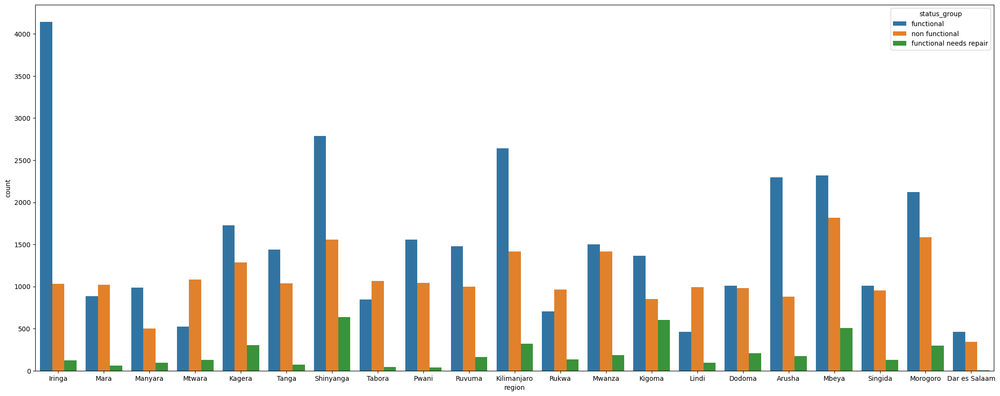

In [18]:
#This work was done by A1
plt.figure(figsize=(26,10))
sns.countplot(x='region', data=twp, hue = 'status_group')

It can be seen over here that number of functional pumps in most of the regions are more than other two except for Lindin Mtwra and few others.
Where as the number of functional and non functional pumps in regions Mara, Rukwa, Dodoma, and few more are nearly equal

Plotting a bar chart for quality of the water according the the status of the pumps

<Axes: xlabel='quantity', ylabel='count'>

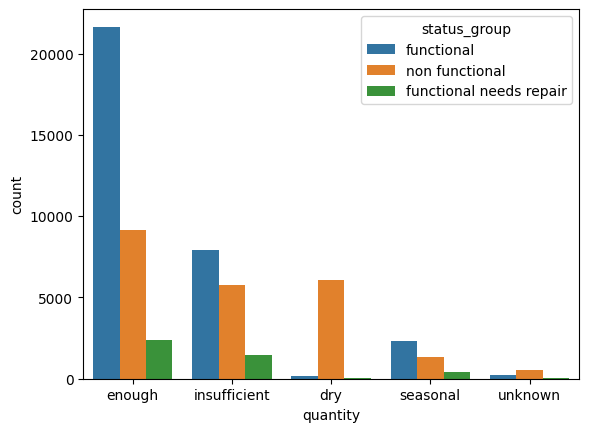

In [14]:
#This work was done by A2
sns.countplot(x='quantity', hue="status_group", data=twp)

As it can be seen form the above graph that number of functional pumps for any quantity of the water are more than nonfunctional or functional but need repairs, enough beint the majority of it,except for 'dry' which means that there is no water remaining in them are nonfunctional

The Barchart represents the different sources of water according to the functionality of water pump 

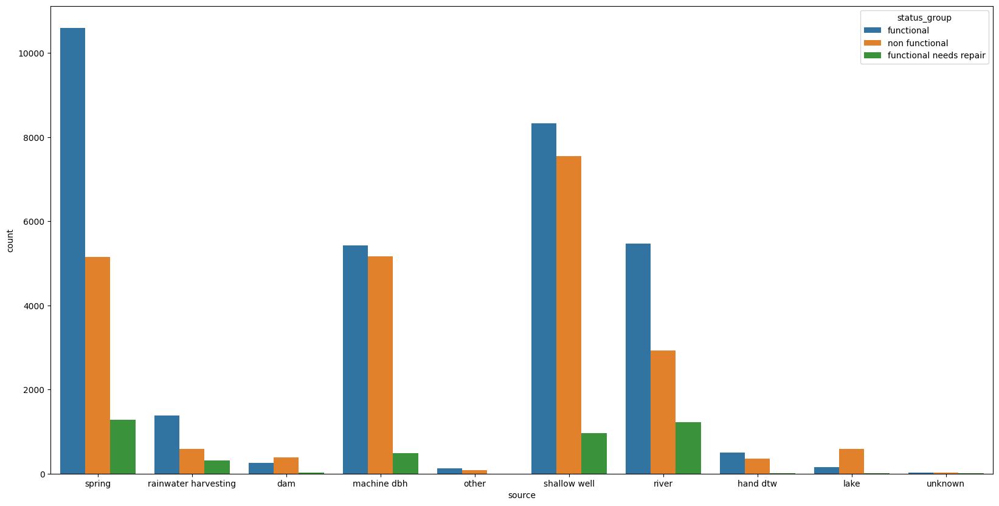

In [15]:
#This work was done by A2
plt.figure(figsize=(20,10))
ax = sns.countplot(x='source', hue="status_group", data=twp)

From this graph it can be seen that most of the sources have nearly equal number of functional and non functional pumps except for spring, river and rain water harvesting

This Bar Chart represents quality of water according to different status of the water pump.

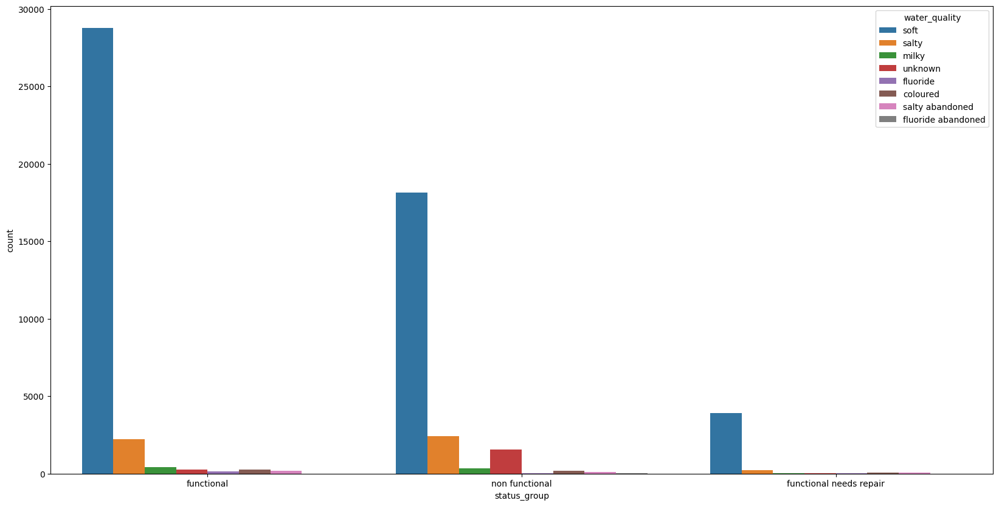

In [21]:
#This work was done by A1
plt.figure(figsize=(20,10))
ax = sns.countplot(x='status_group', hue="water_quality", data=twp)

From the above graph it can be seen that both the columns are correlated since most of the water pumps have soft i.e. good quality of water be it of any category

This bar chart represents status of the water pumps accordint to the payment types

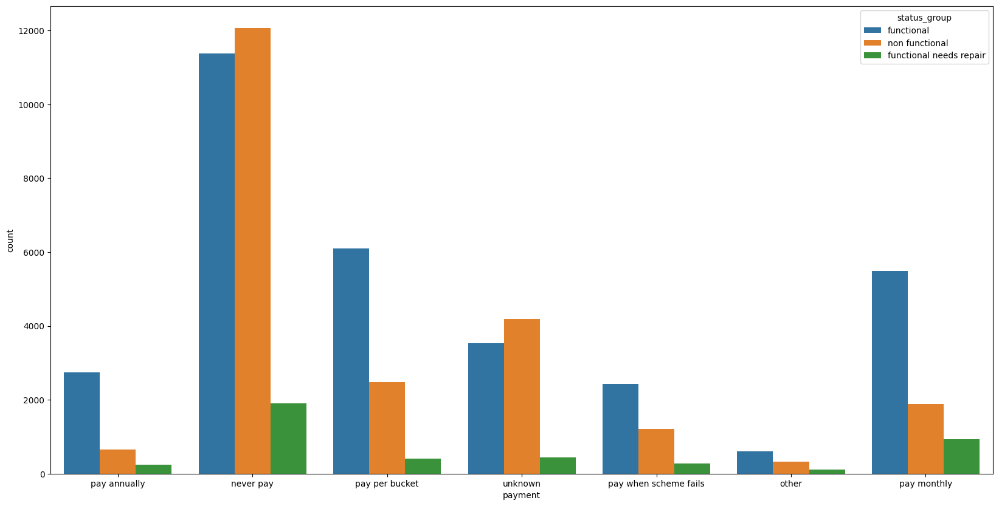

In [22]:
#This work was done by A2
plt.figure(figsize=(20,10))
ax = sns.countplot(x='payment', hue="status_group", data=twp)

From the above graph it can be seen that most of the nonfunctional points are never being paid for or the payment type is unknown

The below bar chart represents status according to the methods they are extracted from the source

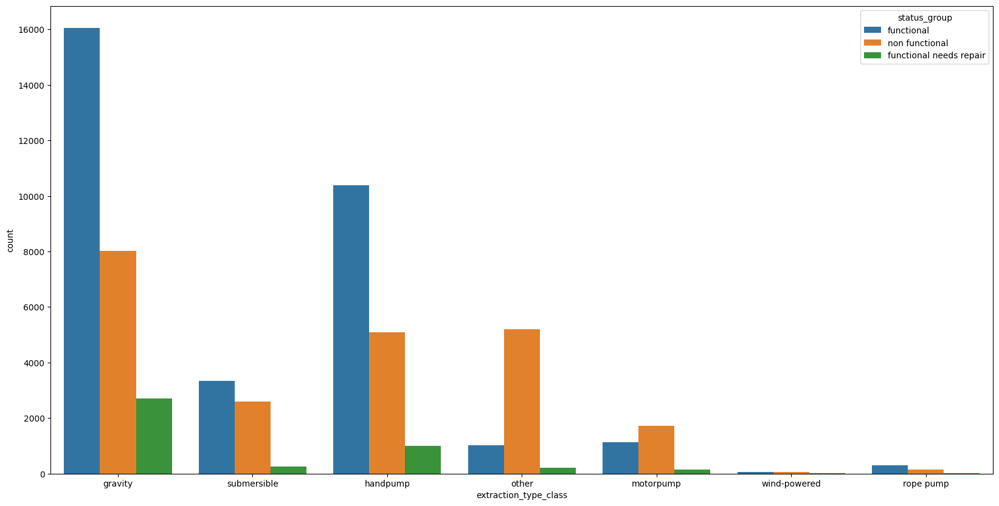

In [23]:
#This work was done by A2
plt.figure(figsize=(20,10))
ax = sns.countplot(x='extraction_type_class', hue="status_group", data=twp)

It can be seen that if the extraction type is other or motarpump have high chance of being non functional so there is a correlation between both the columns

The bar chart represents different water point types and their functionality

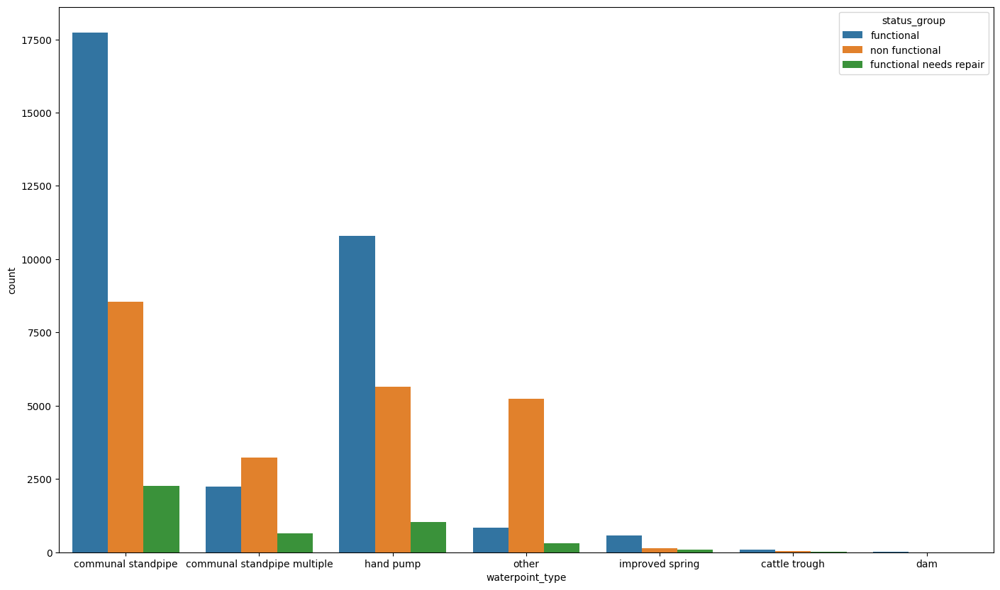

In [24]:
#This work was done by A2
plt.figure(figsize=(17,10))
ax = sns.countplot(x='waterpoint_type', hue="status_group", data=twp)

It can be seen that there is a correlation between waterpoint type and funtionality of water points. The communal standpipe has higher possibility of being functional, however communal standpipe multiple and others have higher chances of being non-functionality.

In this scatter plot we have plotted the data points according to the longitude and the latidude of the water pump

<Axes: xlabel='longitude', ylabel='latitude'>

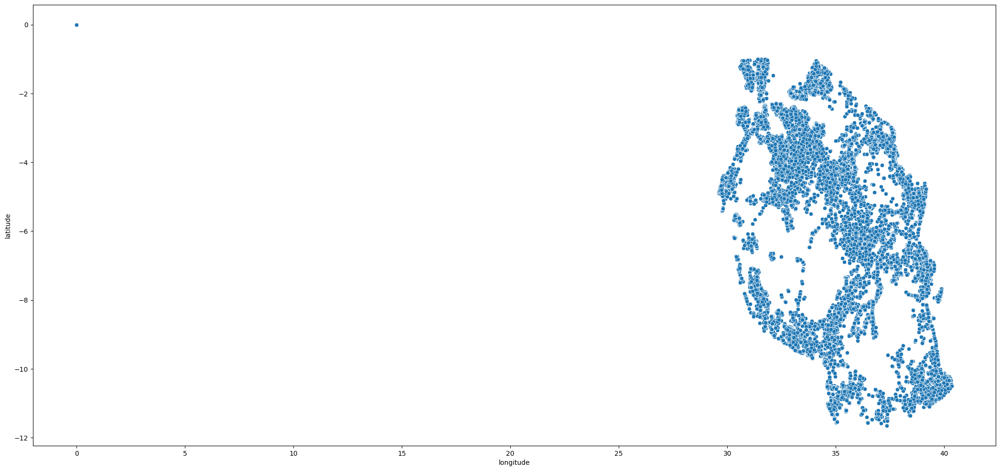

In [25]:
#This work was done by A1
plt.figure(figsize=(26,12))
sns.scatterplot(data=twp, x="longitude", y="latitude")

As it can be seen that a few data points have coordinates of (0,0) this is an error which we will see again in data cleaning 

This bar chart represents various basins and the functioning of the pumps which draw water from them

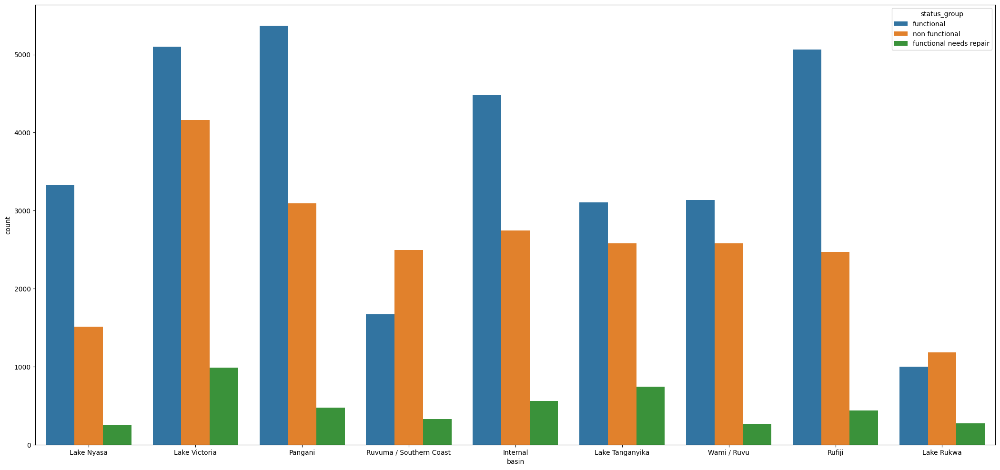

In [26]:
#This work was done by A1
plt.figure(figsize=(26,12))
ax = sns.countplot(x='basin', hue="status_group", data=twp)

As it can be seen that the basins Ruvuma and Lake Rukwa have more nonfunctioning pumps which shows that the status of the pump is related of the basin

The barchart represents the status of water pumps according to the different districts

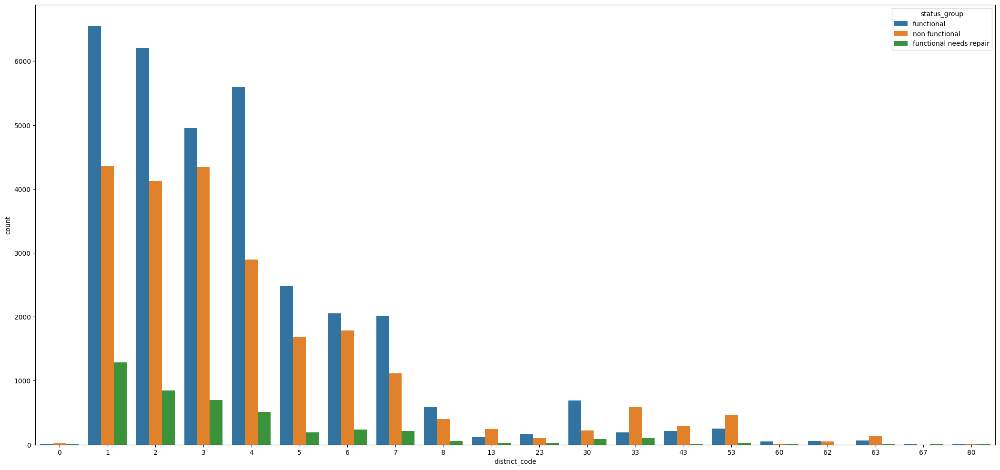

In [27]:
#This work was done by A1
plt.figure(figsize=(26,12))
ax = sns.countplot(x='district_code', hue="status_group", data=twp)

AS it can be seen that the status of the water pumps do depend on the districts since districts such as 1,2 have more functional pumps where as districts such as 33,53 have more non functional pumps.

Plotting a Correlation Matris to see if there is a correlation in any features so we can deal with it.

C:\Users\ALIENWARE\AppData\Local\Temp\ipykernel_6380\219434046.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  train_corr = round(twp.corr(), 2)


<Axes: >

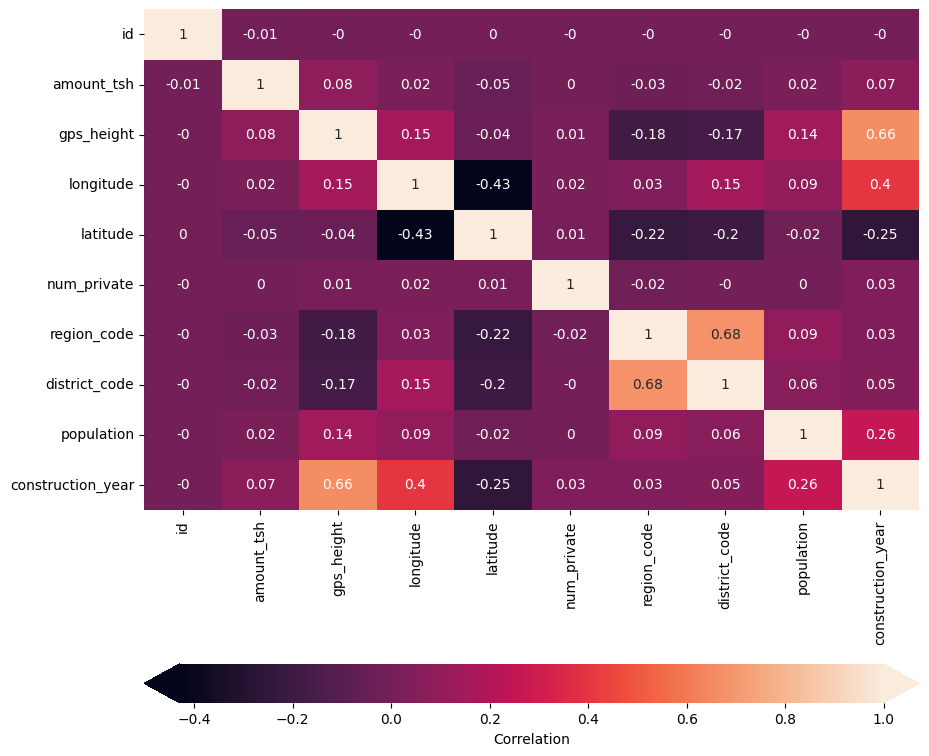

In [28]:
#This work was done by A2
train_corr = round(twp.corr(), 2)
plt.figure(figsize=(10,10))
sns.heatmap(
    data = train_corr,
    annot=True,
    cbar_kws={"label": "Correlation", "orientation": "horizontal", "pad": .2, "extend": "both"}    
)

As it can be seen that features are not highly correplated except for gps_height and construction year or region code and district code.

Plotting a bar chart for status group according to various regions

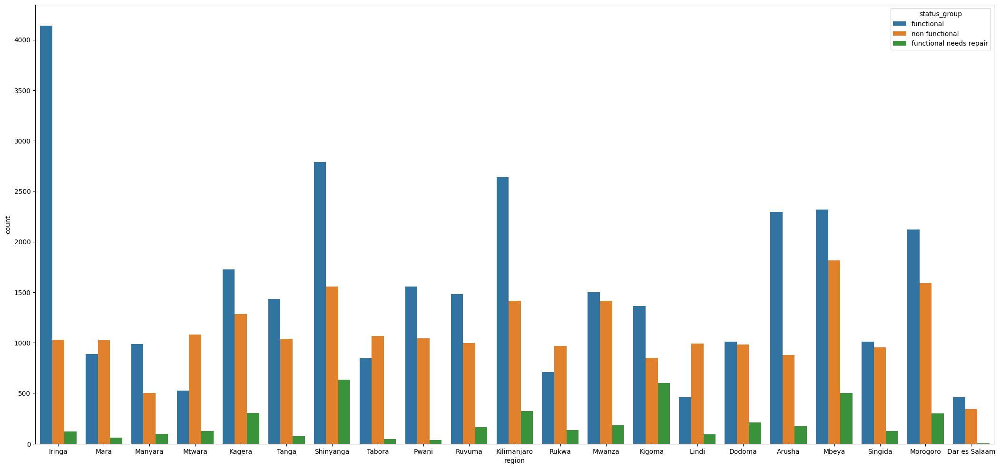

In [29]:
#This work was done by A2
plt.figure(figsize=(26,12))
ax = sns.countplot(x='region', hue="status_group", data=twp)

As it can ne seen that the region and status of the water pump are correlated.

# Data Cleaning and Feature Selection

## Checking various features

Checking management, scheme management and management group

In [30]:
#This work was done by A1
twp['management'].value_counts()

vwc                 40507
wug                  6515
water board          2933
wua                  2535
private operator     1971
parastatal           1768
water authority       904
other                 844
company               685
unknown               561
other - school         99
trust                  78
Name: management, dtype: int64

In [31]:
twp['scheme_management'].value_counts()

VWC                 36793
WUG                  5206
Water authority      3153
WUA                  2883
Water Board          2748
Parastatal           1680
Private operator     1063
Company              1061
Other                 766
SWC                    97
Trust                  72
None                    1
Name: scheme_management, dtype: int64

In [32]:
#Grouping according to management_group anf management columns
twp.groupby(['management_group','management']).count()

id  amount_tsh  date_recorded  funder  \
management_group management                                                   
commercial       company             685         685            685     663   
                 private operator   1971        1971           1971    1957   
                 trust                78          78             78      78   
                 water authority     904         904            904     836   
other            other               844         844            844     837   
                 other - school       99          99             99      99   
parastatal       parastatal         1768        1768           1768    1624   
unknown          unknown             561         561            561     533   
user-group       vwc               40507       40507          40507   37632   
                 water board        2933        2933           2933    2715   
                 wua                2535        2535           2535    2308   
                 wug                6515        6515           6515    6483   

                                   gps_height  installer  longitude  latitude  \
management_group management                                                     
commercial       company                  685        663        685       685   
                 private operator        1971       1959       1971      1971   
                 trust                     78         78         78        78   
                 water authority          904        836        904       904   
other            other                    844        831        844       844   
                 other - school            99         99         99        99   
parastatal       parastatal              1768       1626       1768      1768   
unknown          unknown                  561        527        561       561   
user-group       vwc                    40507      37630      40507     40507   
                 water board             2933       2714       2933      2933   
                 wua                     2535       2309       2535      2535   
                 wug                     6515       6473       6515      6515   

                                   wpt_name  num_private  ...  water_quality  \
management_group management                               ...                  
commercial       company                685          685  ...            685   
                 private operator      1971         1971  ...           1971   
                 trust                   78           78  ...             78   
                 water authority        904          904  ...            904   
other            other                  844          844  ...            844   
                 other - school          99           99  ...             99   
parastatal       parastatal            1768         1768  ...           1768   
unknown          unknown                561          561  ...            561   
user-group       vwc                  40507        40507  ...          40507   
                 water board           2933         2933  ...           2933   
                 wua                   2535         2535  ...           2535   
                 wug                   6515         6515  ...           6515   

                                   quality_group  quantity  quantity_group  \
management_group management                                                  
commercial       company                     685       685             685   
                 private operator           1971      1971            1971   
                 trust                        78        78              78   
                 water authority             904       904             904   
other            other                       844       844             844   
                 other - school               99        99              99   
parastatal       parastatal                 1768   

###### it can be seen that the management is a subgroup of management_group so we drop management group where as management and scheme_management have relatively same values so we drop scheme_management too

Checking for quality and quality_group

In [33]:
twp['quantity'].value_counts()

enough          33186
insufficient    15129
dry              6246
seasonal         4050
unknown           789
Name: quantity, dtype: int64

In [34]:
twp['quantity_group'].value_counts()

enough          33186
insufficient    15129
dry              6246
seasonal         4050
unknown           789
Name: quantity_group, dtype: int64

###### Since both the columns quality and quality_group contain same information we decide to drop quality_group column

 Checking for source, source_type and source_class columns

In [35]:
twp['source'].value_counts()

spring                  17021
shallow well            16824
machine dbh             11075
river                    9612
rainwater harvesting     2295
hand dtw                  874
lake                      765
dam                       656
other                     212
unknown                    66
Name: source, dtype: int64

In [36]:
twp['source_type'].value_counts()

spring                  17021
shallow well            16824
borehole                11949
river/lake              10377
rainwater harvesting     2295
dam                       656
other                     278
Name: source_type, dtype: int64

In [37]:
twp.groupby(['source_class','source']).count()

id  amount_tsh  date_recorded  funder  \
source_class source                                                           
groundwater  hand dtw                874         874            874     868   
             machine dbh           11075       11075          11075   10252   
             shallow well          16824       16824          16824   16302   
             spring                17021       17021          17021   15870   
surface      dam                     656         656            656     647   
             lake                    765         765            765     763   
             rainwater harvesting   2295        2295           2295    2099   
             river                  9612        9612           9612    8715   
unknown      other                   212         212            212     204   
             unknown                  66          66             66      45   

                                   gps_height  installer  longitude  latitude  \
source_class source                                                             
groundwater  hand dtw                     874        868        874       874   
             machine dbh                11075      10246      11075     11075   
             shallow well               16824      16286      16824     16824   
             spring                     17021      15870      17021     17021   
surface      dam                          656        646        656       656   
             lake                         765        762        765       765   
             rainwater harvesting        2295       2096       2295      2295   
             river                       9612       8721       9612      9612   
unknown      other                        212        204        212       212   
             unknown                       66         46         66        66   

                                   wpt_name  num_private  ...  payment  \
source_class source                                       ...            
groundwater  hand dtw                   874          874  ...      874   
             machine dbh              11075        11075  ...    11075   
             shallow well             16824        16824  ...    16824   
             spring                   17021        17021  ...    17021   
surface      dam                        656          656  ...      656   
             lake                       765          765  ...      765   
             rainwater harvesting      2295         2295  ...     2295   
             river                     9612         9612  ...     9612   
unknown      other                      212          212  ...      212   
             unknown                     66           66  ...       66   

                                   payment_type  water_quality  quality_group  \
source_class source                                                             
groundwater  hand dtw                       874            874            874   
             machine dbh                  11075          11075          11075   
             shallow well                 16824          16824          16824   
             spring                       17021          17021          17021   
surface      dam                            656            656            656   
             lake                           765            765            765   
             rainwater harvesting          2295           2295           2295   
             river                         9612           9612           9612   
unknown      other                          212            212            212   
             unknown                         66             66             66   

                                   quantity  quantity_group  source_type  \
source_class source                                                        
groundwater  hand dtw                   874             874          874   
             machine dbh  

###### It can be seen that source is a subgroup of source_class and all the three features contain same values so we decide to keep source and drop the remaining two

 Checking for water_quality and quality_group columns

In [38]:
#This work was done by A2
twp['water_quality'].value_counts()

soft                  50818
salty                  4856
unknown                1876
milky                   804
coloured                490
salty abandoned         339
fluoride                200
fluoride abandoned       17
Name: water_quality, dtype: int64

In [39]:
twp['quality_group'].value_counts()

good        50818
salty        5195
unknown      1876
milky         804
colored       490
fluoride      217
Name: quality_group, dtype: int64

###### it can be seen that both the columns mostly have same values but since water_quality has more options we decide to keep it and drop quality_group

Checking for payment and payment_type columns

In [40]:
twp['payment'].value_counts()

never pay                25348
pay per bucket            8985
pay monthly               8300
unknown                   8157
pay when scheme fails     3914
pay annually              3642
other                     1054
Name: payment, dtype: int64

In [41]:
twp['payment_type'].value_counts()

never pay     25348
per bucket     8985
monthly        8300
unknown        8157
on failure     3914
annually       3642
other          1054
Name: payment_type, dtype: int64

###### We can see that both the columns have same entries so we decide to drop payment_type

Checking for extraction_type, extraction_type_group and extraction_type_class columns

In [42]:
#This work was done by A2
twp['extraction_type'].value_counts()

gravity                      26780
nira/tanira                   8154
other                         6430
submersible                   4764
swn 80                        3670
mono                          2865
india mark ii                 2400
afridev                       1770
ksb                           1415
other - rope pump              451
other - swn 81                 229
windmill                       117
india mark iii                  98
cemo                            90
other - play pump               85
walimi                          48
climax                          32
other - mkulima/shinyanga        2
Name: extraction_type, dtype: int64

In [43]:
twp['extraction_type_group'].value_counts()

gravity            26780
nira/tanira         8154
other               6430
submersible         6179
swn 80              3670
mono                2865
india mark ii       2400
afridev             1770
rope pump            451
other handpump       364
other motorpump      122
wind-powered         117
india mark iii        98
Name: extraction_type_group, dtype: int64

In [44]:
twp.groupby(['extraction_type_class','extraction_type_group']).count()

id  amount_tsh  date_recorded  \
extraction_type_class extraction_type_group                                     
gravity               gravity                26780       26780          26780   
handpump              afridev                 1770        1770           1770   
                      india mark ii           2400        2400           2400   
                      india mark iii            98          98             98   
                      nira/tanira             8154        8154           8154   
                      other handpump           364         364            364   
                      swn 80                  3670        3670           3670   
motorpump             mono                    2865        2865           2865   
                      other motorpump          122         122            122   
other                 other                   6430        6430           6430   
rope pump             rope pump                451         451            451   
submersible           submersible             6179        6179           6179   
wind-powered          wind-powered             117         117            117   

                                             funder  gps_height  installer  \
extraction_type_class extraction_type_group                                  
gravity               gravity                 24704       26780      24714   
handpump              afridev                  1668        1770       1665   
                      india mark ii            2358        2400       2358   
                      india mark iii             98          98         98   
                      nira/tanira              7899        8154       7885   
                      other handpump            353         364        354   
                      swn 80                   3596        3670       3593   
motorpump             mono                     2577        2865       2578   
                      other motorpump           122         122        122   
other                 other                    6010        6430       6002   
rope pump             rope pump                 448         451        448   
submersible           submersible              5820        6179       5816   
wind-powered          wind-powered              112         117        112   

                                             longitude  latitude  wpt_name  \
extraction_type_class extraction_type_group                                  
gravity               gravity                    26780     26780     26780   
handpump              afridev                     1770      1770      1770   
                      india mark ii               2400      2400      2400   
                      india mark iii                98        98        98   
                      nira/tanira                 8154      8154      8154   
                      other handpump               364       364       364   
                      swn 80                      3670      3670      3670   
motorpump             mono                        2865      2865      2865   
                      other motorpump              122       122       122   
other                 other                       6430      6430      6430   
rope pump             rope pump                    451       451       451   
submersible           submersible                 6179      6179      6179   
wind-powered          wind-powered                 117       117       117   

                                             num_private  ...  water_quality  \
extraction_type_class extraction_type_group               ...                  
gravity               gravity                      26780  ...          26780   
handpump              afridev                       1770  ...           1770   
                      india mark ii                 2400  ...           2400   
                      india mark iii                  98  ...             98   
          

###### It is obviously seen that these three columns keep same information. So, we decided to keep 'extraction_type_group' and drop others. Because extraction_type has more unique values than extraction_type_group and some of these values are very small  according to this huge dataset. Also, extraction_type_class contains less detail. So we choose to keep extraction_type_group. We also drop extraction_type

for waterpoint_type and waterpoint_type_group

In [45]:
twp['waterpoint_type'].value_counts()

communal standpipe             28522
hand pump                      17488
other                           6380
communal standpipe multiple     6103
improved spring                  784
cattle trough                    116
dam                                7
Name: waterpoint_type, dtype: int64

In [46]:
twp['waterpoint_type_group'].value_counts()

communal standpipe    34625
hand pump             17488
other                  6380
improved spring         784
cattle trough           116
dam                       7
Name: waterpoint_type_group, dtype: int64

###### We decide to keep waterpoint_type since it has more values.

Checking for recoeded_by 

In [47]:
#This work was done by A1
twp['recorded_by'].unique()

array(['GeoData Consultants Ltd'], dtype=object)

###### Since this column only contains 1 unique value so we decide to delete it

For num_private column

In [48]:
twp['num_private'].value_counts(normalize=True)

0       0.987256
6       0.001364
1       0.001229
5       0.000774
8       0.000774
          ...   
42      0.000017
23      0.000017
136     0.000017
698     0.000017
1402    0.000017
Name: num_private, Length: 65, dtype: float64

###### Since 98% of the data entries in this column are 0 so we drop this feature.

### Data Cleaning

As we saw above in the scatter plot that longitude and latitude had 0 as the ccordinates and it doesnot fall in tanzania so we replace it with respective mean.

In [49]:
#This work was done by A2
# Cleaning for training dataset
long = twp.loc[twp['longitude']!=0]
mean_long = long['longitude'].mean()
twp['longitude'].replace(to_replace = 0 , value =mean_long, inplace=True)

In [50]:
# Cleaning for test dataset
l_test = twp3.loc[twp3['longitude']!=0]
mean_l_test = l_test['longitude'].mean()
twp3['longitude'].replace(to_replace = 0 , value =mean_l_test, inplace=True)

Simmilarly for latitude

In [51]:
# Cleaning for train data set
lati = twp.loc[twp['latitude']!=-2.000000e-08]
mean_lati = lati['latitude'].mean()
twp['latitude'].replace(to_replace = -2.000000e-08 , value =mean_lati, inplace=True)

In [52]:
# Cleaning for test data set
l_test = twp3.loc[twp3['latitude']!=-2.000000e-08]
mean_l_test = l_test['latitude'].mean()
twp3['latitude'].replace(to_replace = -2.000000e-08 , value =mean_l_test, inplace=True)

For public_meeting

In [53]:
twp['public_meeting'].value_counts()

True     51011
False     5055
Name: public_meeting, dtype: int64

In [54]:
#since most of the entries are true we decide to replace the NaN values with True
#For training dataset
twp['public_meeting'].fillna(value=True,inplace=True)
#for testing dataset
twp3['public_meeting'].fillna(value=True,inplace=True)

For permit

In [55]:
twp['permit'].value_counts()

True     38852
False    17492
Name: permit, dtype: int64

In [56]:
#since most of the entries in this column are True we decide to replace the NaN values with True
twp['permit'].fillna(value=True,inplace=True)
#for testing dataset
twp3['permit'].fillna(value=True,inplace=True)

## Cleaning Installers since there are a lots of spelling mistakes and name changes even though they are same

For Training Dataset

In [57]:
#This work was done by A1
# Replacing the NaN values with Unknown
twp['installer'].fillna(value='Unknown',inplace=True)
# Replacing the 0 values with Unknown
twp['installer'].replace(to_replace = '0', value ='Unknown' , inplace=True)

For Testing Data Set

In [58]:
# Replacing the NaN values with Unknown
twp3['installer'].fillna(value='Unknown',inplace=True)
# Replacing the 0 values with Unknown
twp3['installer'].replace(to_replace = '0', value ='Unknown' , inplace=True)

In [59]:
#Finding the top 20 installers and cleaning the data according to them.
#Before
twp['installer'].value_counts().head(20)

DWE                   17402
Unknown                4435
Government             1825
RWE                    1206
Commu                  1060
DANIDA                 1050
KKKT                    898
Hesawa                  840
TCRS                    707
Central government      622
CES                     610
Community               553
DANID                   552
District Council        551
HESAWA                  539
LGA                     408
World vision            408
WEDECO                  397
TASAF                   396
District council        392
Name: installer, dtype: int64

We check the data entries by a part of their name to look for any spelling mistakes. We surach by both Uppercase and Lower case.

In [60]:
fl = twp[twp['installer'].str.contains('DW', regex=True, na=False)]
fl['installer'].unique()

array(['DWE', 'DWSP', 'KKKT _ Konde and DWE', 'RWE/DWE', 'RWEDWE', 'DWE/',
       'DW', 'DWR', 'DWE}', 'DWT', 'DWE /TASSAF',
       'DWE/Ubalozi wa Marekani', 'Consultant and DWE', 'DWE & LWI',
       'RDWS', 'Ubalozi wa Marekani /DWE', 'DWE&', 'DWE/TASSAF', 'DW$',
       'DW E', 'TCRS/DWE', 'DW#', 'DWEB', 'TCRS /DWE', 'Water Aid/DWE',
       'DWW', 'DWE/Anglican church'], dtype=object)

In [61]:
f2 = twp[twp['installer'].str.contains('COMM', regex=True, na=False)]
f2['installer'].unique()

array(['COMMU', 'COMMUNITY', 'COMMUNITY BANK', 'VILLAGE WATER COMMISSION'],
      dtype=object)

In [62]:
f3 = twp[twp['installer'].str.contains(('comm'), regex=True, na=False)]
f3['installer'].unique()

array(['Olgilai village community', 'Arab community',
       'Sekei village community', 'Village community',
       'DADS/village community', 'Ilwilo community', 'Igolola community',
       'Ngiresi village community', 'commu', 'Shelisheli commission',
       'Kitiangare village community', 'Oldadai village community',
       'DADS/Village community', 'TLC/community', 'Maseka community',
       'Islamic community', 'Village community members',
       'TCRS/village community', 'Village water committee'], dtype=object)

In [63]:
f4 = twp[twp['installer'].str.contains('GOV', regex=True, na=False)]
f4['installer'].unique()

array(['GOVERNMENT', 'GOVER', 'GOVERNME', 'CENTRAL GOVERNMENT', 'GOVERM',
       'GOVERN', 'TANZANIAN GOVERNMENT', 'LWI &CENTRAL GOVERNMENT',
       'IRAN GOVERN'], dtype=object)

In [64]:
f5 = twp[twp['installer'].str.contains('gov', regex=True, na=False)]
f5['installer'].unique()

array(['Central government', 'Central govt', 'Village govt',
       'Concern /government', 'central government', 'Italy government',
       'Village government', 'British colonial government',
       'Italian government', 'Centra govt', 'Cetral government /RC',
       'British government', 'Colonial government', 'Tanzania government'],
      dtype=object)

In [65]:
f6 = twp[twp['installer'].str.contains('Gov', regex=True, na=False)]
f6['installer'].unique()

array(['Government', 'Central Government', 'Gove', 'Gover',
       'CIPRO/Government', 'ADRA /Government', 'Japan Government',
       'ISF/Government', 'ADRA/Government', 'RC church/Central Gover',
       'Finland Government', 'Government /TCRS', 'Tanzania Government',
       'Village Govt', 'Government /Community', 'Belgiam Government',
       'Village Government', 'Cental Government', 'Cebtral Government',
       'Governme', 'Government /SDA', 'TCRS /Government',
       'Colonial Government', 'Misri Government', 'Tanzanian Government',
       'Government and Community', 'Concern/Government',
       'Government of Misri', 'Egypt Government', 'Governmen',
       'Government/TCRS', 'Government /World Vision', 'Centra Government'],
      dtype=object)

In [66]:
f7 = twp[twp['installer'].str.contains('DANI', regex=True, na=False)]
f7['installer'].unique()

array(['DANIDA', 'DANID', 'DANIDA CO', 'DANIAD', 'DANIDS'], dtype=object)

In [67]:
f8 = twp[twp['installer'].str.contains('Dani', regex=True, na=False)]
f8['installer'].unique()

array(['Danid', 'Daniel'], dtype=object)

In [68]:
f9 = twp[twp['installer'].str.contains('dani', regex=True, na=False)]
f9['installer'].unique()

array([], dtype=object)

In [69]:
f10 = twp[twp['installer'].str.contains('KKT', regex=True, na=False)]
f10['installer'].unique()

array(['KKKT _ Konde and DWE', 'KKKT', 'KKT C', 'KKKT-Dioces ya Pare',
       'KKKT CHURCH', 'KKKT Leguruki', 'KKT', 'KKKT Ndrumangeni',
       'KKKT DME', 'KKKT Kilinga', 'KKKT Canal', 'KKKT Katiti juu',
       'KKKT MAREU'], dtype=object)

In [70]:
f10 = twp[twp['installer'].str.contains('kkt', regex=True, na=False)]
f10['installer'].unique()

array(['Kkkt'], dtype=object)

In [71]:
f10 = twp[twp['installer'].str.contains('RWE', regex=True, na=False)]
f10['installer'].unique()

array(['RWE', 'RWE/DWE', 'RWEDWE', 'RWE/ Community', 'RWE/Community',
       'RWE /Community', 'RWE Community', 'RWE/TCRS', 'RWET/WESA'],
      dtype=object)

In [72]:
f10 = twp[twp['installer'].str.contains('Rwe', regex=True, na=False)]
f10['installer'].unique()

array([], dtype=object)

In [73]:
f10 = twp[twp['installer'].str.contains('rwe', regex=True, na=False)]
f10['installer'].unique()

array([], dtype=object)

In [74]:
f10 = twp[twp['installer'].str.contains('visi', regex=True, na=False)]
f10['installer'].unique()

array(['World vision', 'World Division', 'Word divisio', 'world vision'],
      dtype=object)

In [75]:
f10 = twp[twp['installer'].str.contains('Visi', regex=True, na=False)]
f10['installer'].unique()

array(['World Vision', 'World Visiin', 'Government /World Vision'],
      dtype=object)

In [76]:
f10 = twp[twp['installer'].str.contains('TCRS', regex=True, na=False)]
f10['installer'].unique()

array(['TCRS', 'TCRS/TLC', 'Government /TCRS', 'TCRS /CARE',
       'CIPRO/CARE/TCRS', 'TCRS Kibondo', 'TCRS.TLC', 'TCRS /Government',
       'TCRS /TWESA', 'TASSAF /TCRS', 'TCRS/CARE', 'TCRS TWESA',
       'RWE/TCRS', 'TCRS/DWE', 'TCRS/village community',
       'Government/TCRS', 'TCRS/TWESA', 'TASSAF/ TCRS', 'TCRS /DWE',
       'TCRS/ TASSAF', 'TCRS/ TWESA', 'TCRS a', 'TASSAF/TCRS'],
      dtype=object)

In [77]:
f10 = twp[twp['installer'].str.contains('RC', regex=True, na=False)]
f10['installer'].unique()

array(['RC Church', 'RC CHURCH', 'RC Churc', 'RCchurch/CEFA', 'IRC', 'RC',
       'RC Ch', 'HW/RC', 'RC church/Central Gover', 'KKKT CHURCH', 'TSRC',
       'RC/Mission', 'RC church/CEFA', 'RC C', 'RC CH', 'TAG CHURCH',
       'RC church', 'RC CATHORIC', 'RC mission', 'ANGLIKANA CHURCH',
       'GLOBAL RESOURCE CONSTRUCTION', 'Cetral government /RC', 'CG/RC',
       'RC MISSIONARY', 'SDA CHURCH', 'METHODIST CHURCH', 'TRC',
       'RC Msufi', 'HAIDOMU LUTHERAN CHURCH', 'BAPTIST CHURCH',
       'RC CHURCH BROTHER', 'GLOBAL RESOURCE CO', 'RC Mi',
       'BAPTIST CHURCH OF TANZANIA', 'RC Njoro', 'RC .Church', 'RC Mis',
       'RC MISSION', 'BATIST CHURCH', 'CHURC'], dtype=object)

In [78]:
f10 = twp[twp['installer'].str.contains('LGA', regex=True, na=False)]
f10['installer'].unique()

array(['LGA', 'TASAFcitizen and LGA'], dtype=object)

In [79]:
f10 = twp[twp['installer'].str.contains('WEDE', regex=True, na=False)]
f10['installer'].unique()

array(['WEDECO', 'WEDECO/WESSONS', 'WEDEKO'], dtype=object)

In [80]:
f10 = twp[twp['installer'].str.contains('Wede', regex=True, na=False)]
f10['installer'].unique()

array(['Wedeco'], dtype=object)

In [81]:
f10 = twp[twp['installer'].str.contains('Hes', regex=True, na=False)]
f10['installer'].unique()

array(['Hesawa', 'Hesewa', 'Hesawz', 'HesaWa'], dtype=object)

In [82]:
f10 = twp[twp['installer'].str.contains('HES', regex=True, na=False)]
f10['installer'].unique()

array(['HESAWA', 'HESAWS', 'HESAW', 'HESAWZ', 'HESAWQ'], dtype=object)

In [83]:
f10 = twp[twp['installer'].str.contains('Tasa', regex=True, na=False)]
f10['installer'].unique()

array(['Tasaf and Lga', 'Tasaf'], dtype=object)

In [84]:
f10 = twp[twp['installer'].str.contains('TASA', regex=True, na=False)]
f10['installer'].unique()

array(['TASAF', 'TASAF/DMDD', 'TASA', 'TASAF and Comunity', 'TASAF/',
       'ISF / TASAFF', 'TASAFcitizen and LGA', 'TASAF and MMEM',
       'TASAF 1', 'TASAF/TLC'], dtype=object)

In [85]:
f10 = twp[twp['installer'].str.contains('UNI', regex=True, na=False)]
f10['installer'].unique()

array(['UNICEF', 'COMMUNITY', 'UNIVERSAL CONSTRUCTION', 'COMMUNITY BANK',
       'UNICRF'], dtype=object)

In [86]:
f10 = twp[twp['installer'].str.contains('Uni', regex=True, na=False)]
f10['installer'].unique()

array(['Unisef', 'European Union', 'Unicef'], dtype=object)

###### Cleaning installer for Testing Dataset

In [87]:
#Replacing the values.
twp['installer'].replace(to_replace = ('DWE', 'DWSP', 'KKKT _ Konde and DWE', 'RWE/DWE', 'RWEDWE', 'DWE/',
                                       'DW', 'DWR', 'DWE}', 'DWT', 'DWE /TASSAF',
                                       'DWE/Ubalozi wa Marekani', 'Consultant and DWE', 'DWE & LWI',
                                       'RDWS', 'Ubalozi wa Marekani /DWE', 'DWE&', 'DWE/TASSAF', 'DW$',
                                       'DW E', 'TCRS/DWE', 'DW#', 'DWEB', 'TCRS /DWE', 'Water Aid/DWE',
                                       'DWW', 'DWE/Anglican church') ,value ='DWE' , inplace=True)

twp['installer'].replace(to_replace=('District water depar','District Water Department', 'Distric Water Department'),
                        value='District Water Department', inplace=True)

twp['installer'].replace(to_replace = ('FINI WATER','FinW','Fini water'), value ='Fini Water', inplace=True)


twp['installer'].replace(to_replace = ('DISTRICT COUNCIL', 'District COUNCIL','District Counci','District  Council', 
                                      'District Council', 'Distri' ,'Council' ,'COUN', 'Counc'),
                                    value ='District council' , inplace=True)

twp['installer'].replace(to_replace = ('RC CHURCH', 'RC Churc','RC Ch','RC C','RC church', 
                                      'RC CATHORIC','RC Church', 'RCchurch/CEFA', 'RC',
       'RC Ch', 'RC church/Central Gover', 'RC/Mission', 'RC church/CEFA', 'RC C', 'RC CH', 'TAG CHURCH',
       'RC church', 'RC CATHORIC', 'RC mission', 'ANGLIKANA CHURCH', 'Cetral government /RC', 'CG/RC',
       'RC CHURCH BROTHER', 'RC Mi', 'RC .Church', 'RC Mis','RC MISSION', 'CHURC') , value ='RC Church' , inplace=True)

twp['installer'].replace(to_replace = ('CENTRAL GOVERNMENT','Central Government','Central govt', 'Centr', 'Centra govt',
                                       'central government','Cental Government', 'Cebtral Government','Centra Government',
                                      'TANZANIAN GOVERNMENT','Tanzanian Government','Tanzania government','Tanzania Government',) ,
                                        value ='Central government' , inplace=True)

twp['installer'].replace(to_replace = ('World vision', 'World Division', 'World vision', 'World Division', 'Word divisio', 
                                      'world vision','World Vision', 'World Visiin', 'Government /World Vision'),
                                        value ='World Vision' , inplace=True)

twp['installer'].replace(to_replace = ('UNICEF','UNICRF','Unisef','Unicef'),value ='UNICEF' , inplace=True)
                                      
twp['installer'].replace(to_replace = ('DANIDA', 'DANID', 'DANIDA CO', 'DANIAD', 'DANIDS'), value ='DANIDA' , inplace=True)

twp['installer'].replace(to_replace = ('villigers', 'villager', 'Villagers', 'Villa', 'Village', 'Villi', 
                                      'Village Council','Village Counil', 'Villages', 'Village Office',
                                      'Village community members','Vill', 'Village community', 
                                      'Villaers', 'Village Community', 'Village council',
                                      'Village  Council','Villagerd', 'Villager', 'Village Technician',
                                      'Villag','Villege Council'),
                                        value ='Villagers' , inplace=True)

twp['installer'].replace(to_replace =('Commu','Communit','commu','COMMU', 'COMMUNITY') ,
                                        value ='Community' , inplace=True)

twp['installer'].replace(to_replace = ('GOVERNMENT', 'GOVER', 'GOVERNME', 'GOVERM','GOVERN','Gover','Gove',
                                      'Governme','Governmen' ) ,value ='Government' , inplace=True)

twp['installer'].replace(to_replace = ('HESAWA', 'HESAWS', 'HESAW', 'HESAWZ', 'HESAWQ','Hesawa', 'Hesewa', 'Hesawz', 'HesaWa') 
                                ,value ='HESAWA' , inplace=True)
                            
twp['installer'].replace(to_replace = ('TASAF', 'TASAF/DMDD', 'TASA', 'TASAF and Comunity', 'TASAF/',
                       'ISF / TASAFF', 'TASAFcitizen and LGA', 'TASAF and MMEM',
                       'TASAF 1', 'TASAF/TLC', 'Tasaf and Lga', 'Tasaf') 
                        ,value ='TASAF' , inplace=True)
                                      
twp['installer'].replace(to_replace =('WEDECO', 'WEDECO/WESSONS', 'WEDEKO','Wedeco') ,
                                        value ='WEDECO' , inplace=True)

twp['installer'].replace(to_replace =('KKKT _ Konde and DWE', 'KKKT', 'KKT C', 'KKKT-Dioces ya Pare',
                                       'KKKT CHURCH', 'KKKT Leguruki', 'KKT', 'KKKT Ndrumangeni',
                                       'KKKT DME', 'KKKT Kilinga', 'KKKT Canal', 'KKKT Katiti juu',
                                       'KKKT MAREU','Kkkt','KKKTK') ,
                                        value ='KKKT' , inplace=True)
twp['installer'].replace(to_replace=('0', 'nan', '-'), value='other', inplace=True)

###### Cleaning installer for Testing Dataset

In [88]:
#Replacing the values.
twp3['installer'].replace(to_replace = ('DWE', 'DWSP', 'KKKT _ Konde and DWE', 'RWE/DWE', 'RWEDWE', 'DWE/',
                                       'DW', 'DWR', 'DWE}', 'DWT', 'DWE /TASSAF',
                                       'DWE/Ubalozi wa Marekani', 'Consultant and DWE', 'DWE & LWI',
                                       'RDWS', 'Ubalozi wa Marekani /DWE', 'DWE&', 'DWE/TASSAF', 'DW$',
                                       'DW E', 'TCRS/DWE', 'DW#', 'DWEB', 'TCRS /DWE', 'Water Aid/DWE',
                                       'DWW', 'DWE/Anglican church') ,value ='DWE' , inplace=True)

twp3['installer'].replace(to_replace=('District water depar','District Water Department', 'Distric Water Department'),
                        value='District Water Department', inplace=True)

twp3['installer'].replace(to_replace = ('FINI WATER','FinW','Fini water'), value ='Fini Water', inplace=True)


twp3['installer'].replace(to_replace = ('DISTRICT COUNCIL', 'District COUNCIL','District Counci','District  Council', 
                                      'District Council', 'Distri' ,'Council' ,'COUN', 'Counc'),
                                    value ='District council' , inplace=True)

twp3['installer'].replace(to_replace = ('RC CHURCH', 'RC Churc','RC Ch','RC C','RC church', 
                                      'RC CATHORIC','RC Church', 'RCchurch/CEFA', 'RC',
       'RC Ch', 'RC church/Central Gover', 'RC/Mission', 'RC church/CEFA', 'RC C', 'RC CH', 'TAG CHURCH',
       'RC church', 'RC CATHORIC', 'RC mission', 'ANGLIKANA CHURCH', 'Cetral government /RC', 'CG/RC',
       'RC CHURCH BROTHER', 'RC Mi', 'RC .Church', 'RC Mis','RC MISSION', 'CHURC') , value ='RC Church' , inplace=True)

twp3['installer'].replace(to_replace = ('CENTRAL GOVERNMENT','Central Government','Central govt', 'Centr', 'Centra govt',
                                       'central government','Cental Government', 'Cebtral Government','Centra Government',
                                      'TANZANIAN GOVERNMENT','Tanzanian Government','Tanzania government','Tanzania Government',) ,
                                        value ='Central government' , inplace=True)

twp3['installer'].replace(to_replace = ('World vision', 'World Division', 'World vision', 'World Division', 'Word divisio', 
                                      'world vision','World Vision', 'World Visiin', 'Government /World Vision'),
                                        value ='World Vision' , inplace=True)

twp3['installer'].replace(to_replace = ('UNICEF','UNICRF','Unisef','Unicef'),value ='UNICEF' , inplace=True)
                                      
twp3['installer'].replace(to_replace = ('DANIDA', 'DANID', 'DANIDA CO', 'DANIAD', 'DANIDS'), value ='DANIDA' , inplace=True)

twp3['installer'].replace(to_replace = ('villigers', 'villager', 'Villagers', 'Villa', 'Village', 'Villi', 
                                      'Village Council','Village Counil', 'Villages', 'Village Office',
                                      'Village community members','Vill', 'Village community', 
                                      'Villaers', 'Village Community', 'Village council',
                                      'Village  Council','Villagerd', 'Villager', 'Village Technician',
                                      'Villag','Villege Council'),
                                        value ='Villagers' , inplace=True)

twp3['installer'].replace(to_replace =('Commu','Communit','commu','COMMU', 'COMMUNITY') ,
                                        value ='Community' , inplace=True)

twp3['installer'].replace(to_replace = ('GOVERNMENT', 'GOVER', 'GOVERNME', 'GOVERM','GOVERN','Gover','Gove',
                                      'Governme','Governmen' ) ,value ='Government' , inplace=True)

twp3['installer'].replace(to_replace = ('HESAWA', 'HESAWS', 'HESAW', 'HESAWZ', 'HESAWQ','Hesawa', 'Hesewa', 'Hesawz', 'HesaWa') 
                                ,value ='HESAWA' , inplace=True)
                            
twp3['installer'].replace(to_replace = ('TASAF', 'TASAF/DMDD', 'TASA', 'TASAF and Comunity', 'TASAF/',
                       'ISF / TASAFF', 'TASAFcitizen and LGA', 'TASAF and MMEM',
                       'TASAF 1', 'TASAF/TLC', 'Tasaf and Lga', 'Tasaf') 
                        ,value ='TASAF' , inplace=True)
                                      
twp3['installer'].replace(to_replace =('WEDECO', 'WEDECO/WESSONS', 'WEDEKO','Wedeco') ,
                                        value ='WEDECO' , inplace=True)

twp3['installer'].replace(to_replace =('KKKT _ Konde and DWE', 'KKKT', 'KKT C', 'KKKT-Dioces ya Pare',
                                       'KKKT CHURCH', 'KKKT Leguruki', 'KKT', 'KKKT Ndrumangeni',
                                       'KKKT DME', 'KKKT Kilinga', 'KKKT Canal', 'KKKT Katiti juu',
                                       'KKKT MAREU','Kkkt','KKKTK') ,
                                        value ='KKKT' , inplace=True)
twp3['installer'].replace(to_replace=('0', 'nan', '-'), value='other', inplace=True)

In [89]:
#After
twp['installer'].value_counts().head(20)

DWE                   18115
Unknown                4435
Government             2660
Community              1674
DANIDA                 1605
HESAWA                 1386
RWE                    1206
District council       1179
Central government     1114
KKKT                   1025
TCRS                    707
World Vision            684
CES                     610
Fini Water              593
RC Church               515
TASAF                   442
LGA                     408
WEDECO                  406
Villagers               395
UNICEF                  333
Name: installer, dtype: int64

###### For Funder doing the same as above

In [90]:
#This work was done by A2
#Cleaning Training Dataset
twp['funder'].fillna(value='Unknown',inplace=True)
twp['funder'].replace(to_replace = '0', value ='Unknown' , inplace=True)

In [91]:
#Cleaning Testing Dataset
twp3['funder'].fillna(value='Unknown',inplace=True)
twp3['funder'].replace(to_replace = '0', value ='Unknown' , inplace=True)

In [92]:
# Before
twp['funder'].value_counts().head(20)

Government Of Tanzania    9084
Unknown                   4416
Danida                    3114
Hesawa                    2202
Rwssp                     1374
World Bank                1349
Kkkt                      1287
World Vision              1246
Unicef                    1057
Tasaf                      877
District Council           843
Dhv                        829
Private Individual         826
Dwsp                       811
Norad                      765
Germany Republi            610
Tcrs                       602
Ministry Of Water          590
Water                      583
Dwe                        484
Name: funder, dtype: int64

In [93]:
w = twp[twp['funder'].str.contains('gov', regex=True, na=False)]
w['funder'].unique()

array(['Norad /government', 'Cipro/government', 'Isf/government',
       'Tcrs /government', 'Danida /government', 'Dhv/gove',
       'Concern /govern', 'Vgovernment', 'World Bank/government',
       'Concern/governm', 'Unhcr/government', 'Norad/government'],
      dtype=object)

In [94]:
w = twp[twp['funder'].str.contains('Gov', regex=True, na=False)]
w['funder'].unique()

array(['Government Of Tanzania', 'British Colonial Government',
       'Government/ Community', 'Japan Government', 'China Government',
       'Finidagermantanzania Govt', 'Government /tassaf',
       'Finida German Tanzania Govt', 'Finland Government',
       'Village Government', 'Village Govt', 'Government/ World Bank',
       'Belgian Government', 'Lwi & Central Government',
       'Italy Government', 'Government', 'Irish Government',
       'Government /sda', 'Koica And Tanzania Government',
       'Colonial Government', 'Misri Government',
       'Government And Community', 'Government Of Misri',
       'Egypt Government', 'Government/tassaf', 'Iran Gover',
       'Government/school', 'Government/tcrs', 'Government /world Vision'],
      dtype=object)

In [95]:
w = twp[twp['funder'].str.contains('Dan', regex=True, na=False)]
w['funder'].unique()

array(['Danida', 'Danida /government', 'Tassaf/ Danida'], dtype=object)

In [96]:
w = twp[twp['funder'].str.contains('dan', regex=True, na=False)]
w['funder'].unique()

array(['Ms-danish', 'Unhcr/danida'], dtype=object)

In [97]:
w = twp[twp['funder'].str.contains('Hes', regex=True, na=False)]
w['funder'].unique()

array(['Hesawa', 'Hesawz', 'Hesaw', 'Hesawwa', 'Hesawza', 'Hesswa',
       'Hesawa And Concern World Wide'], dtype=object)

In [98]:
w = twp[twp['funder'].str.contains('hes', regex=True, na=False)]
w['funder'].unique()

array(['Huches', 'Hhesawa'], dtype=object)

In [99]:
w = twp[twp['funder'].str.contains('Rws', regex=True, na=False)]
w['funder'].unique()

array(['Rwssp', 'Rwsso', 'Rwsp', 'Rwssp/wsdp', 'Rwsssp',
       'Rwssp Shinyanga'], dtype=object)

In [100]:
w = twp[twp['funder'].str.contains('rws', regex=True, na=False)]
w['funder'].unique()

array(['Ded/rwssp', 'Nrwssp', 'Drwssp', 'Ded_rwsp'], dtype=object)

In [101]:
w = twp[twp['funder'].str.contains('Wor', regex=True, na=False)]
w['funder'].unique()

array(['World Vision', 'Concern World Wide', 'World Bank',
       'Bread For The Wor', 'World Vision/ Kkkt',
       'Government/ World Bank', 'World Vision/adra', 'Bread Of The Worl',
       'World Bank/government', 'Muslim World', 'Worldvision',
       'World Vision/rc Church', 'Hesawa And Concern World Wide'],
      dtype=object)

In [102]:
w = twp[twp['funder'].str.contains('wor', regex=True, na=False)]
w['funder'].unique()

array(['African 2000 Network', 'Africa 2000 Network/undp',
       'Government /world Vision'], dtype=object)

In [103]:
w = twp[twp['funder'].str.contains('Ban', regex=True, na=False)]
w['funder'].unique()

array(['African Development Bank', 'World Bank', 'Bank',
       'Government/ World Bank', 'World Bank/government',
       'Community Bank', 'Banca Reale'], dtype=object)

In [104]:

w = twp[twp['funder'].str.contains('Vis', regex=True, na=False)]
w['funder'].unique()

array(['World Vision', 'World Vision/ Kkkt', 'World Vision/adra',
       'World Vision/rc Church', 'Government /world Vision'], dtype=object)

In [105]:
w = twp[twp['funder'].str.contains('vis', regex=True, na=False)]
w['funder'].unique()

array(['Game Division', 'Worldvision'], dtype=object)

In [106]:
w = twp[twp['funder'].str.contains('kk', regex=True, na=False)]
w['funder'].unique()

array(['Kkkt_makwale', 'Kkkt', 'Kkkt-dioces Ya Pare',
       'World Vision/ Kkkt', 'Kkkt Church', 'Kkkt Leguruki',
       'Kkkt Ndrumangeni', 'Kkkt Dme', 'Kkkt Canal', 'Kkkt Usa',
       'Kkkt Mareu'], dtype=object)

In [107]:
w = twp[twp['funder'].str.contains('Uni', regex=True, na=False)]
w['funder'].unique()

array(['Unicef', 'European Union', 'Unice/ Cspd', 'Unice', 'Unicef/ Csp',
       'Oikos E.Africa/european Union', 'Oikos E .Africa/european Union',
       'Unicef/central', 'Professor Ben Ohio University',
       'Unicef/african Muslim Agency', 'Unicrf', 'Unicet', 'Unicef/cspd',
       'Uniceg', 'Uniseg', 'Oikos E.Africa/ European Union'], dtype=object)

In [108]:
w = twp[twp['funder'].str.contains('Tas', regex=True, na=False)]
w['funder'].unique()

array(['Tasaf', 'Tassaf', 'Tasaf And Lga', 'Tasaf Ii', 'Tasae',
       'Tassaf I', 'Tasafu', 'Tasaf/dmdd', 'Norad/ Tassaf Ii',
       'Tassaf Ii', 'Tasf', 'Isf / Tasaff', 'Tasad', 'Tassaf/ Danida',
       'Tasaf And Mmem', 'Tasaf 1', 'Tasef', 'Norad/ Tassaf', 'Tasaf/tlc',
       'Tasa'], dtype=object)

In [109]:
w = twp[twp['funder'].str.contains('Dh', regex=True, na=False)]
w['funder'].unique()

array(['Dhv', 'Dhv\\norp', 'Dhv Moro', 'Dh', 'Dhv/gove', 'Dhinu',
       'Dhv\\swis'], dtype=object)

In [110]:
w = twp[twp['funder'].str.contains('Dw', regex=True, na=False)]
w['funder'].unique()

array(['Dwsp', 'Dwe/norad', 'Dwe', 'Dw', 'Dwssp', 'Dwt',
       'Dwe/bamboo Projec', 'Dwe/ubalozi Wa Marekani', 'Dwst', 'Dwsdp',
       'Dwe/rudep', 'Dwe And Veo', 'Dwarf', 'Dwe/anglican Church'],
      dtype=object)

In [111]:
w = twp[twp['funder'].str.contains('Nor', regex=True, na=False)]
w['funder'].unique()

array(['Norad', 'Norad /government', 'Norad/ Kidep', 'Norad/ Tassaf Ii',
       'Norani', 'Nordic', 'Bridge North', 'Norway Aid', 'Norplan',
       'Norad/ Tassaf', 'Norad/japan', 'Norad/rudep', 'Norad/government'],
      dtype=object)

In [112]:
w = twp[twp['funder'].str.contains('Ger', regex=True, na=False)]
w['funder'].unique()

array(['Germany Republi', 'Germany', 'Finida German Tanzania Govt',
       'A/co Germany', 'Germany Misionary', 'German Missionary',
       'Germany Cristians', 'Bingo Foundation Germany',
       'Africa Project Ev Germany', 'Germany Missionary',
       'Gerald Tuseko Gro', 'Tree Ways German'], dtype=object)

In [113]:
w = twp[twp['funder'].str.contains('Tc', regex=True, na=False)]
w['funder'].unique()

array(['Tcrs', 'Tcrs.Tlc', 'Tcrs /government', 'Tcrs /care', 'Tcrst',
       'Tcrs/care', 'Tcrs Kibondo', 'Tcrs/village Community'],
      dtype=object)

In [114]:
w = twp[twp['funder'].str.contains('tcrs', regex=True, na=False)]
w['funder'].unique()

array(['Cipro/care/tcrs', 'Government/tcrs'], dtype=object)

In [115]:
w = twp[twp['funder'].str.contains('Dwe', regex=True, na=False)]
w['funder'].unique()

array(['Dwe/norad', 'Dwe', 'Dwe/bamboo Projec', 'Dwe/ubalozi Wa Marekani',
       'Dwe/rudep', 'Dwe And Veo', 'Dwe/anglican Church'], dtype=object)

In [116]:
w = twp[twp['funder'].str.contains('dwe', regex=True, na=False)]
w['funder'].unique()

array(['Rudep /dwe', 'Care/dwe', 'Rc/dwe', 'Abddwe', 'Water Aid/dwe'],
      dtype=object)

###### Cleaning funder for Training dataset

In [117]:
twp['funder'].replace(to_replace =('Government Of Tanzania','Government','Government /sda','Koica And Tanzania Government',
                                 'Government And Community','Government/school','Concern /govern','Concern/governm') ,
                                        value ='Government of Tanzania' , inplace=True)

twp['funder'].replace(to_replace =('Danida', 'Danida /government', 'Tassaf/ Danida','Unhcr/danida') ,
                                        value ='Danida' , inplace=True)

twp['funder'].replace(to_replace =('Hesawa', 'Hesawz', 'Hesaw', 'Hesawwa', 'Hesawza', 'Hesswa',
                                   'Hesawa And Concern World Wide','Hhesawa') ,
                                        value ='Hesawa' , inplace=True)

twp['funder'].replace(to_replace =('Rwssp', 'Rwsso', 'Rwsp', 'Rwssp/wsdp', 'Rwsssp',
                                  'Rwssp Shinyanga','Ded/rwssp', 'Nrwssp', 'Drwssp', 'Ded_rwsp') ,
                                        value ='Rwssp' , inplace=True)

twp['funder'].replace(to_replace =('World Bank','World Bank/government') ,
                                        value ='World Bank' , inplace=True)

twp['funder'].replace(to_replace =('World Vision/adra','World Vision/rc Church','Worldvision','Government /world Vision') ,
                                        value ='World Vision' , inplace=True)

twp['funder'].replace(to_replace =('Kkkt_makwale', 'Kkkt', 'Kkkt-dioces Ya Pare',
                                   'World Vision/ Kkkt', 'Kkkt Church', 'Kkkt Leguruki',
                                   'Kkkt Ndrumangeni', 'Kkkt Dme', 'Kkkt Canal', 'Kkkt Usa', 'Kkkt Mareu') ,
                                        value ='KKKT' , inplace=True)

twp['funder'].replace(to_replace =('Unicef','Unice/ Cspd', 'Unice', 'Unicef/ Csp','Unicef/central',
                                  'Unicef/african Muslim Agency', 'Unicrf', 'Unicet', 'Unicef/cspd','Uniceg', 'Uniseg') ,
                                        value ='UNICEF' , inplace=True)

twp['funder'].replace(to_replace =('Tasaf', 'Tassaf', 'Tasaf And Lga', 'Tasaf Ii', 'Tasae',
                                   'Tassaf I', 'Tasafu', 'Tasaf/dmdd',
                                   'Tassaf Ii', 'Tasf', 'Tasad','Tasaf And Mmem',  
                                  'Tasaf 1', 'Tasef', 'Tasaf/tlc','Tasa') ,
                                        value ='Tasaf' , inplace=True)

twp['funder'].replace(to_replace =('Dhv', 'Dhv\\norp', 'Dhv Moro', 'Dh', 'Dhv/gove', 'Dhv\\swis') ,
                                        value ='Dhv' , inplace=True)

twp['funder'].replace(to_replace =('Dwst', 'Dwsdp','Dwsp') ,
                                        value ='DWSP' , inplace=True)

twp['funder'].replace(to_replace =('Norad','Norani', 'Nordic') ,
                                        value ='Norad' , inplace=True)

twp['funder'].replace(to_replace =('German Republi') ,
                                        value ='German Republic' , inplace=True)

twp['funder'].replace(to_replace =('Tcrs', 'Tcrs.Tlc', 'Tcrs /care', 'Tcrst',
                                   'Tcrs/care', 'Tcrs Kibondo','Cipro/care/tcrs') ,
                                        value ='Tcrs' , inplace=True)

###### Cleaning funder for Testing dataset

In [118]:
twp3['funder'].replace(to_replace =('Government Of Tanzania','Government','Government /sda','Koica And Tanzania Government',
                                 'Government And Community','Government/school','Concern /govern','Concern/governm') ,
                                        value ='Government of Tanzania' , inplace=True)

twp3['funder'].replace(to_replace =('Danida', 'Danida /government', 'Tassaf/ Danida','Unhcr/danida') ,
                                        value ='Danida' , inplace=True)

twp3['funder'].replace(to_replace =('Hesawa', 'Hesawz', 'Hesaw', 'Hesawwa', 'Hesawza', 'Hesswa',
                                   'Hesawa And Concern World Wide','Hhesawa') ,
                                        value ='Hesawa' , inplace=True)

twp3['funder'].replace(to_replace =('Rwssp', 'Rwsso', 'Rwsp', 'Rwssp/wsdp', 'Rwsssp',
                                  'Rwssp Shinyanga','Ded/rwssp', 'Nrwssp', 'Drwssp', 'Ded_rwsp') ,
                                        value ='Rwssp' , inplace=True)

twp3['funder'].replace(to_replace =('World Bank','World Bank/government') ,
                                        value ='World Bank' , inplace=True)

twp3['funder'].replace(to_replace =('World Vision/adra','World Vision/rc Church','Worldvision','Government /world Vision') ,
                                        value ='World Vision' , inplace=True)

twp3['funder'].replace(to_replace =('Kkkt_makwale', 'Kkkt', 'Kkkt-dioces Ya Pare',
                                   'World Vision/ Kkkt', 'Kkkt Church', 'Kkkt Leguruki',
                                   'Kkkt Ndrumangeni', 'Kkkt Dme', 'Kkkt Canal', 'Kkkt Usa', 'Kkkt Mareu') ,
                                        value ='KKKT' , inplace=True)

twp3['funder'].replace(to_replace =('Unicef','Unice/ Cspd', 'Unice', 'Unicef/ Csp','Unicef/central',
                                  'Unicef/african Muslim Agency', 'Unicrf', 'Unicet', 'Unicef/cspd','Uniceg', 'Uniseg') ,
                                        value ='UNICEF' , inplace=True)

twp3['funder'].replace(to_replace =('Tasaf', 'Tassaf', 'Tasaf And Lga', 'Tasaf Ii', 'Tasae',
                                   'Tassaf I', 'Tasafu', 'Tasaf/dmdd',
                                   'Tassaf Ii', 'Tasf', 'Tasad','Tasaf And Mmem',  
                                  'Tasaf 1', 'Tasef', 'Tasaf/tlc','Tasa') ,
                                        value ='Tasaf' , inplace=True)

twp3['funder'].replace(to_replace =('Dhv', 'Dhv\\norp', 'Dhv Moro', 'Dh', 'Dhv/gove', 'Dhv\\swis') ,
                                        value ='Dhv' , inplace=True)

twp3['funder'].replace(to_replace =('Dwst', 'Dwsdp','Dwsp') ,
                                        value ='DWSP' , inplace=True)

twp3['funder'].replace(to_replace =('Norad','Norani', 'Nordic') ,
                                        value ='Norad' , inplace=True)

twp3['funder'].replace(to_replace =('German Republi') ,
                                        value ='German Republic' , inplace=True)

twp3['funder'].replace(to_replace =('Tcrs', 'Tcrs.Tlc', 'Tcrs /care', 'Tcrst',
                                   'Tcrs/care', 'Tcrs Kibondo','Cipro/care/tcrs') ,
                                        value ='Tcrs' , inplace=True)

In [119]:
# After
twp['funder'].value_counts().head(20)

Government of Tanzania    9101
Unknown                   4416
Danida                    3124
Hesawa                    2217
KKKT                      1546
Rwssp                     1413
World Bank                1350
World Vision              1278
UNICEF                    1202
Dhv                       1104
Tasaf                     1054
District Council           843
Private Individual         826
DWSP                       813
Norad                      767
Tcrs                       621
Germany Republi            610
Ministry Of Water          590
Water                      583
Dwe                        484
Name: funder, dtype: int64

###### Forming bins for construction years according to decades

In [120]:
#This work was done by A2
# Before
twp['construction_year'].unique()

array([1999, 2010, 2009, 1986,    0, 2011, 1987, 1991, 1978, 1992, 2008,
       1974, 2000, 2002, 2004, 1972, 2003, 1980, 2007, 1973, 1985, 1970,
       1995, 2006, 1962, 2005, 1997, 2012, 1996, 1977, 1983, 1984, 1990,
       1982, 1976, 1988, 1989, 1975, 1960, 1961, 1998, 1963, 1971, 1994,
       1968, 1993, 2001, 1979, 1967, 2013, 1969, 1981, 1964, 1966, 1965],
      dtype=int64)

In [121]:
def construction_cl(row):
    if row['construction_year'] >= 1960 and row['construction_year'] < 1970:
        return '60s'
    elif row['construction_year'] >= 1970 and row['construction_year'] < 1980:
        return '70s'
    elif row['construction_year'] >= 1980 and row['construction_year'] < 1990:
        return '80s'
    elif row['construction_year'] >= 1990 and row['construction_year'] < 2000:
        return '90s'
    elif row['construction_year'] >= 2000 and row['construction_year'] < 2010:
        return '00s'
    elif row['construction_year'] >= 2010:
        return '10s'
    else:
        return 'unknown'
    
twp['construction_decade'] = twp.apply(lambda row: construction_cl(row), axis=1)
twp3['construction_decade'] = twp3.apply(lambda row: construction_cl(row), axis=1)

In [122]:
# After
twp['construction_decade'].unique()

array(['90s', '10s', '00s', '80s', 'unknown', '70s', '60s'], dtype=object)

### Dropping the columns

In [123]:
twp.drop(columns=['management_group','scheme_management','quantity_group','source_class','source_type','quality_group',
                'payment_type','extraction_type_class','extraction_type', 'waterpoint_type_group','recorded_by',
                'num_private','date_recorded','wpt_name','region_code','subvillage','scheme_name','construction_year'], inplace=True)

twp3.drop(columns=['management_group','scheme_management','quantity_group','source_class','source_type','quality_group',
                'payment_type','extraction_type_class','extraction_type', 'waterpoint_type_group','recorded_by',
                'num_private','date_recorded','wpt_name','region_code','subvillage','scheme_name','construction_year'], inplace=True)


## Encoding the Data

###### Replacing the names in status_group with functional-0, functional needs repair-1, non functional-2 

In [124]:
sg ={'functional':0, 'functional needs repair': 1, 'non functional': 2} 
twp['status_group']=twp['status_group'].replace(sg)

In [125]:
twp['status_group'].value_counts()

0    32259
2    22824
1     4317
Name: status_group, dtype: int64

Encoding public_meeting and permit

In [126]:
#This work was done by A2
# For Train Dataset
twp['public_meeting'].replace({True: 1, False: 0},inplace=True)
twp['permit'].replace({True: 1, False: 0},inplace=True)

In [127]:
#For Test Dataset
twp3['public_meeting'].replace({True: 1, False: 0},inplace=True)
twp3['permit'].replace({True: 1, False: 0},inplace=True)

In [128]:
twp.head().T

,0,1,2,3,4
id,69572,8776,34310,67743,19728
amount_tsh,6000.0,0.0,25.0,0.0,0.0
funder,Roman,Grumeti,Lottery Club,UNICEF,Action In A
gps_height,1390,1399,686,263,0
installer,Roman,GRUMETI,World Vision,UNICEF,Artisan
longitude,34.938093,34.698766,37.460664,38.486161,31.130847
latitude,-9.856322,-2.147466,-3.821329,-11.155298,-1.825359
basin,Lake Nyasa,Lake Victoria,Pangani,Ruvuma / Southern Coast,Lake Victoria
region,Iringa,Mara,Manyara,Mtwara,Kagera
district_code,5,2,4,63,1


In [129]:
twp.isna().sum()

id                       0
amount_tsh               0
funder                   0
gps_height               0
installer                0
longitude                0
latitude                 0
basin                    0
region                   0
district_code            0
lga                      0
ward                     0
population               0
public_meeting           0
permit                   0
extraction_type_group    0
management               0
payment                  0
water_quality            0
quantity                 0
source                   0
waterpoint_type          0
status_group             0
construction_decade      0
dtype: int64

# Modeling

###### Importing all the models and important libraries

In [148]:
#for Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier

#for LGBM classifier
import lightgbm as lgb
from lightgbm import LGBMClassifier

#For XGB Classifier
import xgboost as xgb
from xgboost import XGBClassifier

#For data preprocessing
from sklearn.preprocessing import RobustScaler
from sklearn.compose import ColumnTransformer
from category_encoders import TargetEncoder
import category_encoders as ce

#For Pipeline
from sklearn.pipeline import make_pipeline, Pipeline

#For Model Selection
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score
from mlxtend.plotting import plot_confusion_matrix


#For Evaluation 
from sklearn.metrics import roc_auc_score, precision_score, recall_score, accuracy_score, f1_score, confusion_matrix


#### Creating X and y variables for training and testing the dataset

In [131]:
#This work was done by A1
#X for features
X = twp.drop(columns=['status_group'])
#y for the target
y = twp['status_group']

### Splitting the variables in categorical and numerical variables

In [132]:
# Creating a list for categorical variables
categorical = ['funder', 'installer','basin','region','lga','ward','extraction_type_group','construction_decade','management','payment','water_quality','quantity',
               'source','waterpoint_type']

#Creating a list for numerical variables
numerical = ['amount_tsh','gps_height','longitude','latitude','district_code','population','public_meeting','permit']

Splitting the data using train_test_split()

In [133]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Creating a dataframe for storing the model name and their accuracies

In [134]:
res = pd.DataFrame(columns=["Model", 'train_accuracy','accuracy', 'precision','recall','f1-score','CV_Score'])


###### Creating a object for RobustScaler for numerical variables and TargetEncoder for categorical variables

In [135]:
#This work was done by A1
scaler = RobustScaler()
encoder = ce.TargetEncoder(cols=categorical)

In [136]:
# Making pipeline for numerical variables
n_trans = make_pipeline(scaler)
c_trans = make_pipeline(encoder)

In [137]:
#Transforming the numerical and categorical values.
pre_processor = ColumnTransformer(
      transformers=[('num', n_trans, numerical),
                    ('cat', c_trans, categorical)])

# Random Forest

In [138]:
#This work was done by A1
#Creating an object for Random Forest Classifier
rfc = RandomForestClassifier(n_estimators=1000, 
                            min_samples_split=6,
                            criterion='gini', 
                            max_features='auto',
                            oob_score=True,
                            random_state=1,
                            n_jobs=-1)

In [139]:
#Making a pipe for preprocessing and the model
rfc_pipe = make_pipeline(pre_processor,rfc)

In [140]:
#Fitting the dataset
rfc_pipe.fit(X_train,y_train)
#Predicting the features used for training the data
y_train_pred = rfc_pipe.predict(X_train)

#Predicting for the test data
y_test_pred = rfc_pipe.predict(X_test)

In [141]:
#Printing the evaluations for train and test both
print("Train data:")
print(f"Accuracy: {accuracy_score(y_train, y_train_pred)}")
print(f"Precision: {precision_score(y_train, y_train_pred, average='macro')}")
print(f"Recall: {recall_score(y_train, y_train_pred, average='macro')}")
print(f"F1-Score: {f1_score(y_train, y_train_pred, average='macro')}")
print(f'Test data')
print(f"Accuracy: {accuracy_score(y_test_pred, y_test)}")
print(f"Precision: {precision_score(y_test_pred, y_test, average='macro')}")
print(f"Recall: {recall_score(y_test_pred, y_test, average='macro')}")
print(f"F1-Score: {f1_score(y_test_pred, y_test, average='macro')}")

Train data:
Accuracy: 0.9456018518518519
Precision: 0.9437146978420833
Recall: 0.8780297713929414
F1-Score: 0.9058158127938123
Test data
Accuracy: 0.811026936026936
Precision: 0.6720201092404201
Recall: 0.7448216097862791
F1-Score: 0.6964237317187852


In [142]:
#Cross Validation for RF Classifier and printing all the 5 cv scores and their mean
rfc_cv = cross_val_score(rfc_pipe, X, y, cv=5, scoring='accuracy')
print('--------------------------------------------------------------------------------------------------')
print(f"Cross-Validation Scores RFC Classifier: {rfc_cv}, with a Mean of :{np.mean(rfc_cv)}")
cv= np.mean(rfc_cv)

--------------------------------------------------------------------------------------------------
Cross-Validation Scores RFC Classifier: [0.81430976 0.80917508 0.80959596 0.80707071 0.80909091], with a Mean of :0.8098484848484848


In [143]:
#Adding to the data frame
res.loc[0] = ['Random Forest Classifier', accuracy_score(y_train, y_train_pred),accuracy_score(y_test_pred, y_test),precision_score(y_test_pred, y_test, average='macro'),recall_score(y_test_pred, y_test, average='macro'),f1_score(y_test_pred, y_test, average='macro'),cv]

In [145]:
#Printing feature importance
rfc.feature_importances_

array([0.0186831 , 0.04941702, 0.0939144 , 0.09102437, 0.01715695,
       0.03537484, 0.00572121, 0.00620779, 0.06708039, 0.05818061,
       0.01524579, 0.01820382, 0.03569719, 0.14414483, 0.05357301,
       0.02235787, 0.01478909, 0.03043122, 0.01209401, 0.12682394,
       0.02428969, 0.05958885])

Text(0.5, 1.0, 'Feature Importance')

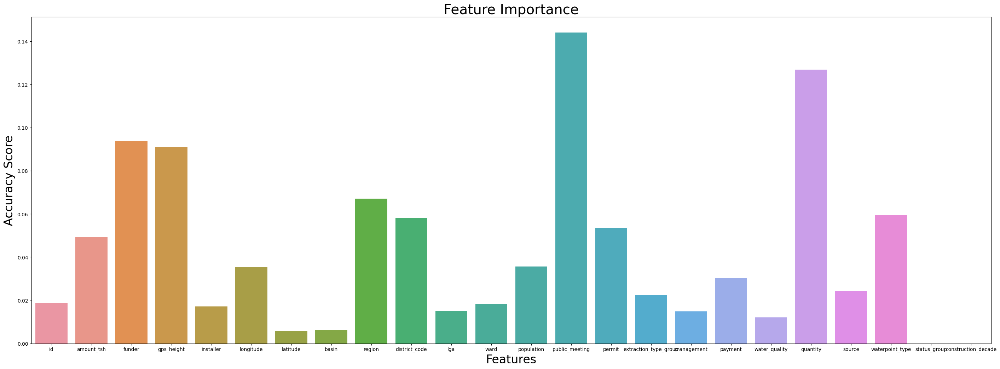

In [146]:
#Creating a bar chart for feature importance in random forest
s = twp.columns.to_list()
s = pd.Series(s)
r = pd.Series(rfc.feature_importances_)
dg = pd.DataFrame([s, r], index=['Features', 'Accuracy Score']).T
plt.figure(figsize=(35,12))
ax = sns.barplot(x=s, y=r, data=s)
plt.xlabel('Features',fontsize=24)
plt.ylabel('Accuracy Score',fontsize=24)
plt.title('Feature Importance',fontsize=28)

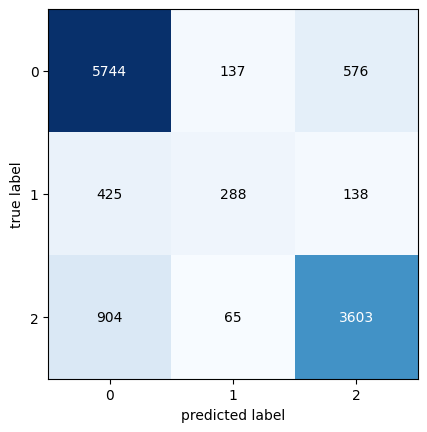

In [149]:
#Plotting a confusion matrix
cm = confusion_matrix(y_test, y_test_pred)
plot_confusion_matrix(cm)
plt.show()

# LGBM

In [150]:
#This work was done by A2
#Creating an object for LGBM classifier
lgbm = LGBMClassifier(booster = 'gbtree', nrounds = 'min.error.idx', maximize = False,eta = .1,max_depth = 10, 
                      colsample_bytree = .4,learning_rate = 0.1,max_delta_step=1)

In [151]:
#Making a pipeline for preprocessing and model
lgbm_pipe = make_pipeline(pre_processor,lgbm)
#Fitting the model
lgbm_pipe.fit(X_train, y_train)

[LightGBM] [Warning] Unknown parameter: booster
[LightGBM] [Warning] Unknown parameter: nrounds
[LightGBM] [Warning] Unknown parameter: maximize
[LightGBM] [Warning] learning_rate is set=0.1, eta=0.1 will be ignored. Current value: learning_rate=0.1


Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('robustscaler',
                                                                   RobustScaler())]),
                                                  ['amount_tsh', 'gps_height',
                                                   'longitude', 'latitude',
                                                   'district_code',
                                                   'population',
                                                   'public_meeting',
                                                   'permit']),
                                                 ('cat',
                                                  Pipeline(steps=[('targetencoder',
                                                                   TargetEncoder(cols=['funder',
                                                                                       'installer',
                                                                                       'basin',
                                                                                       'region',
                                                                                       'lga',
                                                                                       'ward',
                                                                                       'extra...
                                                                                       'waterpoint_type']))]),
                                                  ['funder', 'installer',
                                                   'basin', 'region', 'lga',
                                                   'ward',
                                                   'extraction_type_group',
                                                   'construction_decade',
                                                   'management', 'payment',
                                                   'water_quality', 'quantity',
                                                   'source',
                                                   'waterpoint_type'])])),
                ('lgbmclassifier',
                 LGBMClassifier(booster='gbtree', colsample_bytree=0.4, eta=0.1,
                                max_delta_step=1, max_depth=10, maximize=False,
                                nrounds='min.error.idx'))])

In [152]:
#Predicting the data used for training the model
y_train_pred = lgbm_pipe.predict(X_train)
#Predicting the test data
y_test_pred = lgbm_pipe.predict(X_test)
#Printing the Evaluations for training and testing data
print("Train data:")
print(f"Accuracy: {accuracy_score(y_train, y_train_pred)}")
print(f"Precision: {precision_score(y_train, y_train_pred, average='macro')}")
print(f"Recall: {recall_score(y_train, y_train_pred, average='macro')}")
print(f"F1-Score: {f1_score(y_train, y_train_pred, average='macro')}")
print(f'Test data')
print(f"Accuracy: {accuracy_score(y_test_pred, y_test)}")
print(f"Precision: {precision_score(y_test_pred, y_test, average='macro')}")
print(f"Recall: {recall_score(y_test_pred, y_test, average='macro')}")
print(f"F1-Score: {f1_score(y_test_pred, y_test, average='macro')}")

Train data:
Accuracy: 0.8175084175084175
Precision: 0.7927069426713401
Recall: 0.6538151699208017
F1-Score: 0.6859357057819145
Test data
Accuracy: 0.7937710437710438
Precision: 0.6281035764158042
Recall: 0.7555647916194711
F1-Score: 0.6569706288233531


In [153]:
#Cross Validation for LGBM Classifier and printing all the 5 cv scores and their mean
lgbm_cv = cross_val_score(lgbm_pipe, X, y, cv=5, scoring='accuracy')
print('--------------------------------------------------------------------------------------------------')
print(f"Cross-Validation Scores LGBM Classifier: {lgbm_cv}, with a Mean of :{np.mean(lgbm_cv)}")
cv= np.mean(lgbm_cv)

[LightGBM] [Warning] Unknown parameter: booster
[LightGBM] [Warning] Unknown parameter: nrounds
[LightGBM] [Warning] Unknown parameter: maximize
[LightGBM] [Warning] learning_rate is set=0.1, eta=0.1 will be ignored. Current value: learning_rate=0.1
[LightGBM] [Warning] Unknown parameter: booster
[LightGBM] [Warning] Unknown parameter: nrounds
[LightGBM] [Warning] Unknown parameter: maximize
[LightGBM] [Warning] learning_rate is set=0.1, eta=0.1 will be ignored. Current value: learning_rate=0.1
[LightGBM] [Warning] Unknown parameter: booster
[LightGBM] [Warning] Unknown parameter: nrounds
[LightGBM] [Warning] Unknown parameter: maximize
[LightGBM] [Warning] learning_rate is set=0.1, eta=0.1 will be ignored. Current value: learning_rate=0.1
[LightGBM] [Warning] Unknown parameter: booster
[LightGBM] [Warning] Unknown parameter: nrounds
[LightGBM] [Warning] Unknown parameter: maximize
[LightGBM] [Warning] learning_rate is set=0.1, eta=0.1 will be ignored. Current value: learning_rate=0.1


In [154]:
#adding the data for LGBM to the results data frame
res.loc[1] = ['LGBM Classifier', accuracy_score(y_train, y_train_pred),accuracy_score(y_test_pred, y_test),precision_score(y_test_pred, y_test, average='macro'),recall_score(y_test_pred, y_test, average='macro'),f1_score(y_test_pred, y_test, average='macro'),cv]

In [155]:
#Printing LGBM Feature importance
print(lgbm.feature_importances_)

[241 589 780 788 327 426  67  87 676 668 220 396 758 683 420 317 235 251
 172 329 312 258]


Text(0.5, 1.0, 'Feature Importance')

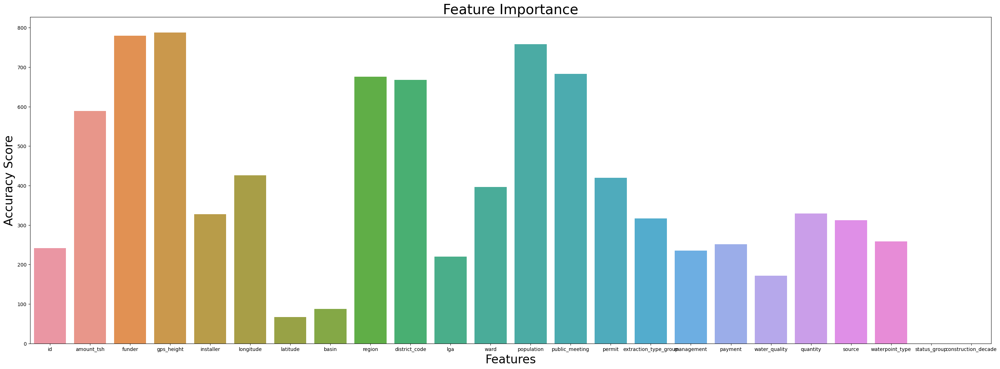

In [156]:
#Plotting a Bargraph According to importance of all the features
s = twp.columns.to_list()
s = pd.Series(s)
r = pd.Series(lgbm.feature_importances_)
dg = pd.DataFrame([s, r], index=['Features', 'Accuracy Score']).T
plt.figure(figsize=(35,12))
ax = sns.barplot(x=s, y=r, data=s)
plt.xlabel('Features',fontsize=24)
plt.ylabel('Accuracy Score',fontsize=24)
plt.title('Feature Importance',fontsize=28)

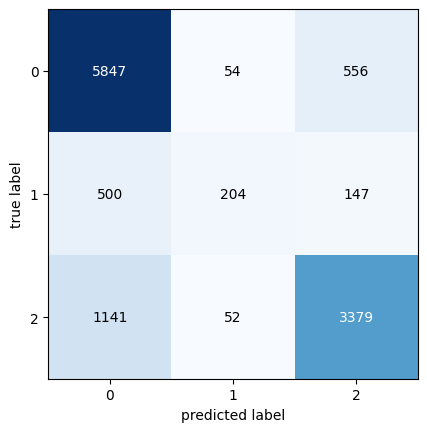

In [157]:
#Plotting a confussion matrix for LGBM Classifier
cm = confusion_matrix(y_test, y_test_pred)
plot_confusion_matrix(cm)
plt.show()

# XG Boost

In [158]:
#This Work was done together by both A1 and A2
#Creating an object for XGB Classifier
xgb = XGBClassifier(objective = 'multi:softmax', booster = 'gbtree', nrounds = 'min.error.idx',
                      num_class = 3, maximize = False, eval_metric = 'merror', eta = .1,
                      max_depth = 10, colsample_bytree = .4, n_jobs = -1,learning_rate = 0.05)

In [159]:
#Making a pipe for preprocessing and model of XGB classifier
xgb_pipe = make_pipeline(pre_processor,xgb)
# Fitting the model for training data
xgb_pipe.fit(X_train, y_train)

[03:59:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "maximize", "nrounds" } are not used.



Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('robustscaler',
                                                                   RobustScaler())]),
                                                  ['amount_tsh', 'gps_height',
                                                   'longitude', 'latitude',
                                                   'district_code',
                                                   'population',
                                                   'public_meeting',
                                                   'permit']),
                                                 ('cat',
                                                  Pipeline(steps=[('targetencoder',
                                                                   TargetEncoder(cols=['funder',
                                                                                       'installer',
                                                                                       'basin',
                                                                                       'region',
                                                                                       'lga',
                                                                                       'ward',
                                                                                       'extra...
                               gamma=None, gpu_id=None, grow_policy=None,
                               importance_type=None,
                               interaction_constraints=None, learning_rate=0.05,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=10, max_leaves=None, maximize=False,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=100,
                               n_jobs=-1, nrounds='min.error.idx', ...))])

In [160]:
#Predicting the training data used for fitting the model
y_train_pred = xgb_pipe.predict(X_train)

#Predicting the test data
y_test_pred = xgb_pipe.predict(X_test)
#Printing the Evaluations
print("Train data:")
print(f"Accuracy: {accuracy_score(y_train, y_train_pred)}")
print(f"Precision: {precision_score(y_train, y_train_pred, average='macro')}")
print(f"Recall: {recall_score(y_train, y_train_pred, average='macro')}")
print(f"F1-Score: {f1_score(y_train, y_train_pred, average='macro')}")
print(f'Test data')
print(f"Accuracy: {accuracy_score(y_test_pred, y_test)}")
print(f"Precision: {precision_score(y_test_pred, y_test, average='macro')}")
print(f"Recall: {recall_score(y_test_pred, y_test, average='macro')}")
print(f"F1-Score: {f1_score(y_test_pred, y_test, average='macro')}")

Train data:
Accuracy: 0.8573442760942761
Precision: 0.8632158524469541
Recall: 0.7000363262853916
F1-Score: 0.7396717532209477
Test data
Accuracy: 0.802946127946128
Precision: 0.6390681126856983
Recall: 0.7833964387872733
F1-Score: 0.6706546448281178


In [161]:
#Cross Validation for XGB Classifier and printing all the 5 cv scores and their mean
xgb_cv = cross_val_score(xgb_pipe, X, y, cv=5, scoring='accuracy')
print('--------------------------------------------------------------------------------------------------')
print(f"Cross-Validation Scores LGBM Classifier: {xgb_cv}, with a Mean of :{np.mean(xgb_cv)}")
cv= np.mean(xgb_cv)

[03:59:32] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "maximize", "nrounds" } are not used.

[03:59:56] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "maximize", "nrounds" } are not used.

[04:00:19] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "maximize", "nrounds" } are not used.

[04:00:43] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "maximize", "nrounds" } are not used.

[04:01:07] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-07593ffd91cd9da33-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Paramete

In [162]:
#Adding data to results dataframe
res.loc[2] = ['XGB Classifier', accuracy_score(y_train, y_train_pred),accuracy_score(y_test_pred, y_test),precision_score(y_test_pred, y_test, average='macro'),recall_score(y_test_pred, y_test, average='macro'),f1_score(y_test_pred, y_test, average='macro'),cv]

In [163]:
#Printing Feature importance
print(xgb.feature_importances_)

[0.02543401 0.01161362 0.01661358 0.0163691  0.01872716 0.0127529
 0.02225021 0.01628042 0.03727778 0.0327759  0.02310861 0.02330454
 0.03492885 0.05920031 0.07988305 0.02782699 0.01829158 0.03750863
 0.02265552 0.3006319  0.0346748  0.12789051]


Text(0.5, 1.0, 'Feature Importance')

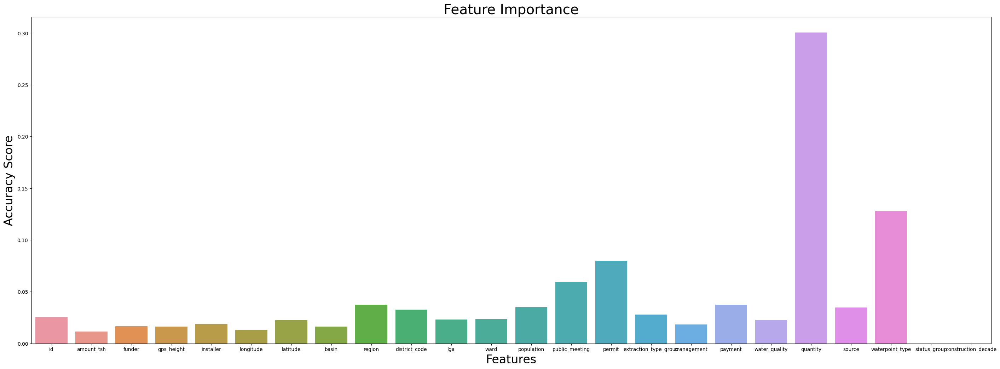

In [164]:
#PLotting a bar graph for feature importance
s = twp.columns.to_list()
s = pd.Series(s)
r = pd.Series(xgb.feature_importances_)
dg = pd.DataFrame([s, r], index=['Features', 'Accuracy Score']).T
plt.figure(figsize=(35,12))
ax = sns.barplot(x=s, y=r, data=s)
plt.xlabel('Features',fontsize=24)
plt.ylabel('Accuracy Score',fontsize=24)
plt.title('Feature Importance',fontsize=28)

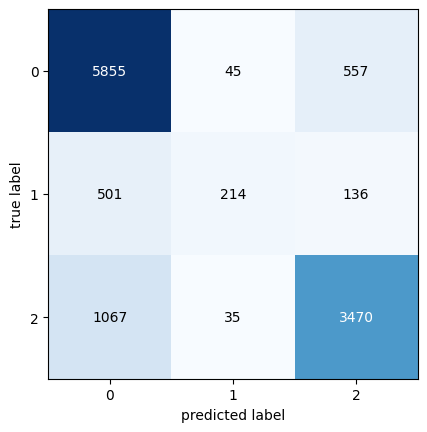

In [165]:
#Printing confusion matrix
cm = confusion_matrix(y_test, y_test_pred)
plot_confusion_matrix(cm)
plt.show()

In [166]:
#Predicting the actual test data from Test_Set.csv
y_train_pred = xgb_pipe.predict(twp3)

In [167]:
y_train_pred

array([0, 0, 0, ..., 0, 0, 2])

In [168]:
#Finding the prediction of probablity
y_train_pred = xgb_pipe.predict_proba(twp3)

In [169]:
y_train_pred

array([[0.46615866, 0.10469257, 0.4291487 ],
       [0.62311697, 0.07719909, 0.29968396],
       [0.78689975, 0.06415512, 0.14894505],
       ...,
       [0.7027306 , 0.12503915, 0.17223032],
       [0.79719055, 0.06986587, 0.1329436 ],
       [0.07064303, 0.02966943, 0.8996875 ]], dtype=float32)

In [170]:
#Printing the Results Column
res

,Model,train_accuracy,accuracy,precision,recall,f1-score,CV_Score
0,Random Forest Classifier,0.945602,0.811027,0.672020,0.744822,0.696424,0.809848
1,LGBM Classifier,0.817508,0.793771,0.628104,0.755565,0.656971,0.788434
2,XGB Classifier,0.857344,0.802946,0.639068,0.783396,0.670655,0.801751


### The Comments have the work done by each member where ever the comments can be seen the part in done by that member untill the next comment arrives.
#### A1 - Aradhya
#### A2 - Aniket